# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
generative_dist = "Isotropic_Gaussian"
learning_rate = 0.001
scheduler_gamma = 0.99
scheduler_step_size = 1
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                              scheduler_gamma=scheduler_gamma, scheduler_step_size=scheduler_step_size)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Isotropic_Gaussian_S1_099.pth


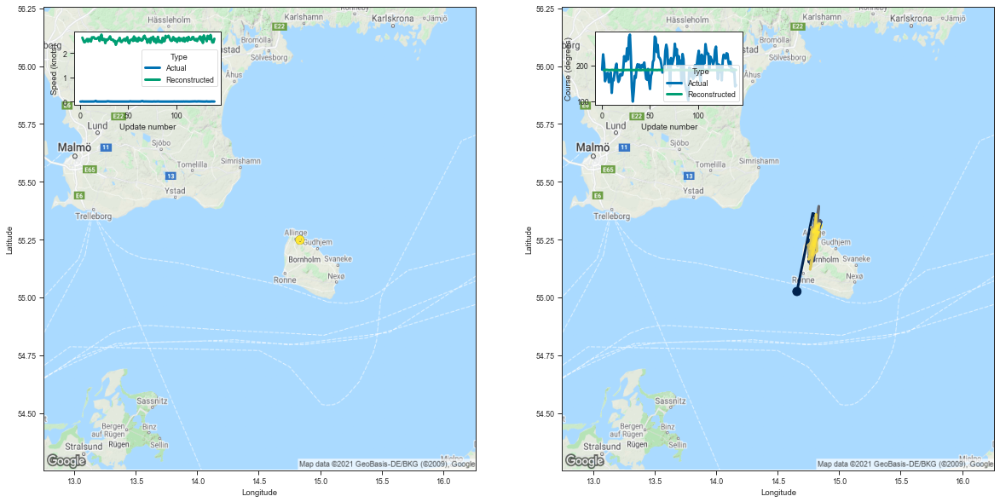

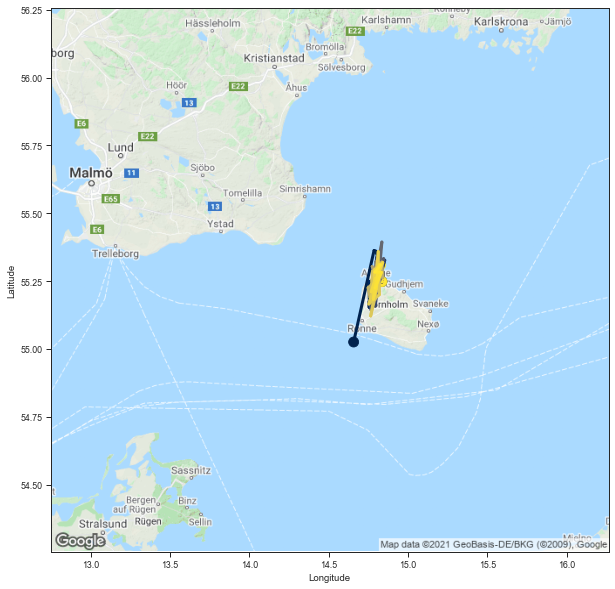

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  2204657  230069190  14.835580  55.247887  0.000000   
1                 0  2204657  230069190  14.835602  55.247890  0.000000   
2                 0  2204657  230069190  14.835603  55.247894  0.007143   
3                 0  2204657  230069190  14.835587  55.247887  0.000000   
4                 0  2204657  230069190  14.835587  55.247890  0.000000   
..              ...      ...        ...        ...        ...       ...   
136               0  2204657  230069190  14.835620  55.247929  0.000000   
137               0  2204657  230069190  14.835623  55.247921  0.004918   
138               0  2204657  230069190  14.835609  55.247913  0.003390   
139               0  2204657  230069190  14.835624  55.247925  0.003226   
140               0  2204657  230069190  14.835603  55.247902  0.001754   

         Course Ship type  Track length          Time stamp  
0    187.841507   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.657051,55.025326,2.641503,185.434708,0.650849,0.122259,3.341731,99.235387
3,14.785628,55.362637,2.540223,187.003418,0.614805,0.076765,3.249287,99.996313
4,14.796633,55.360283,2.449990,187.379242,0.608060,0.059385,3.113516,100.171801
5,14.820552,55.317318,2.463894,187.242218,0.604898,0.051303,3.136020,100.063696
6,14.813717,55.249657,2.534311,187.043976,0.614912,0.061272,3.192124,99.939391
...,...,...,...,...,...,...,...,...
136,14.818268,55.310658,2.751548,186.362335,0.639105,0.073053,3.424003,99.784318
137,14.791707,55.224205,2.567695,186.761642,0.624315,0.069341,3.222508,99.844977
138,14.832356,55.281910,2.441722,187.267044,0.608731,0.054256,3.157220,100.059328
139,14.790951,55.282768,2.447905,187.153534,0.612263,0.064770,3.132478,100.131539


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Isotropic_Gaussian_lr5e-05.pth


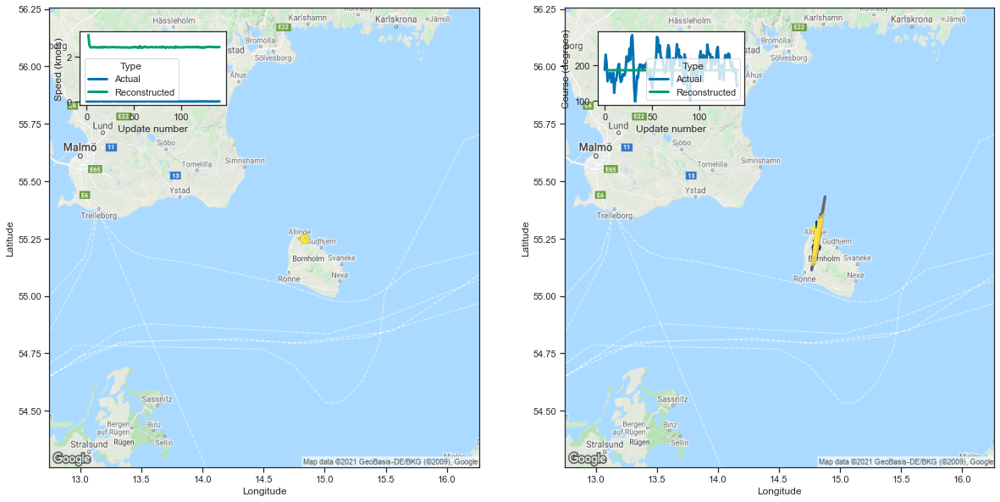

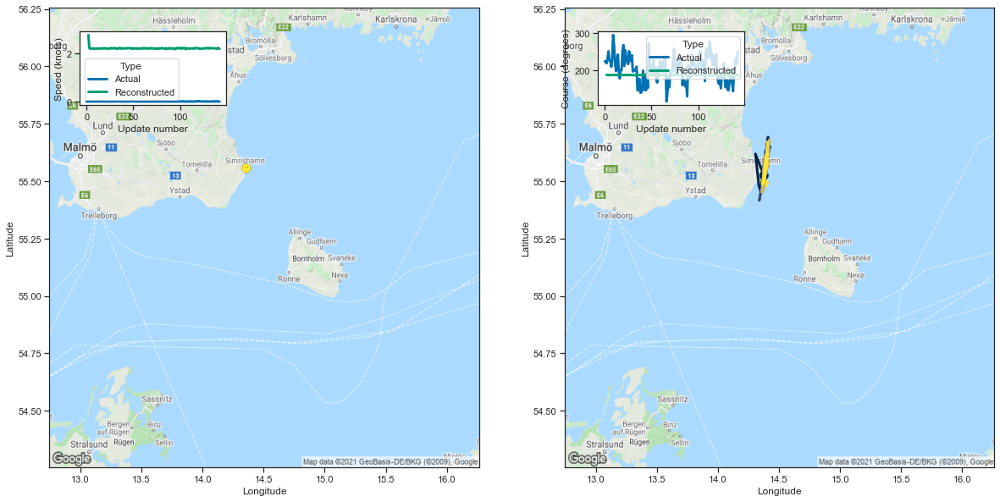

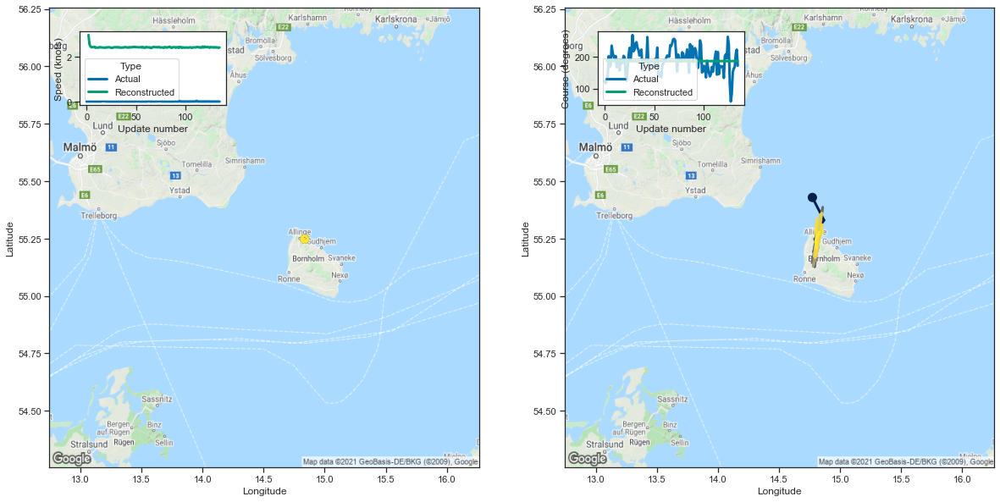

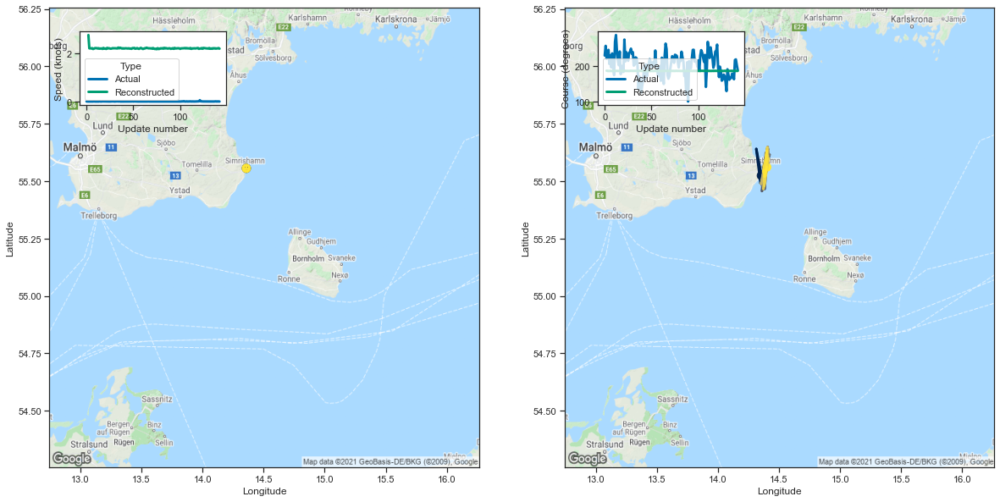

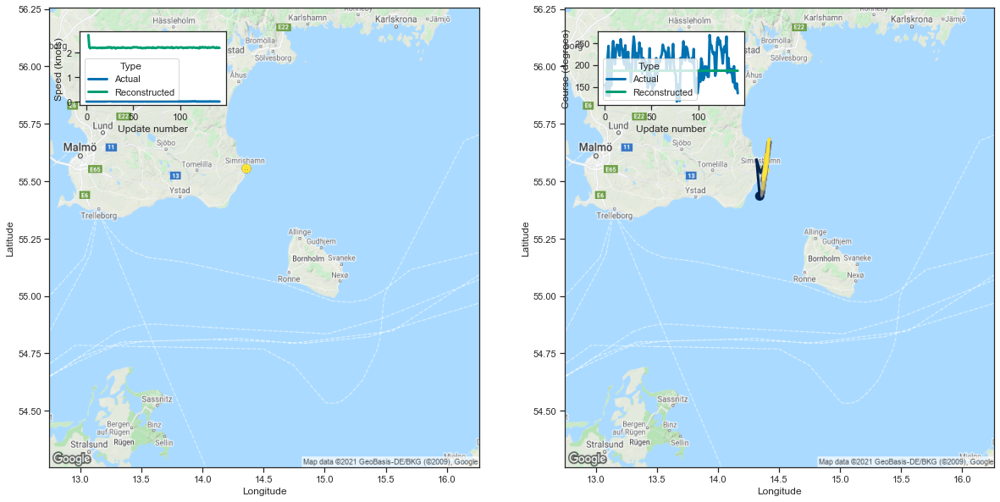

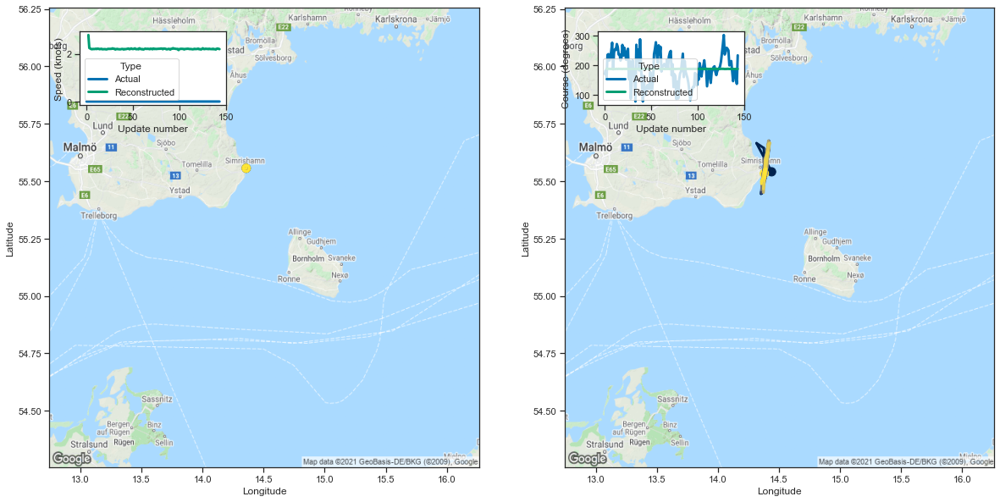

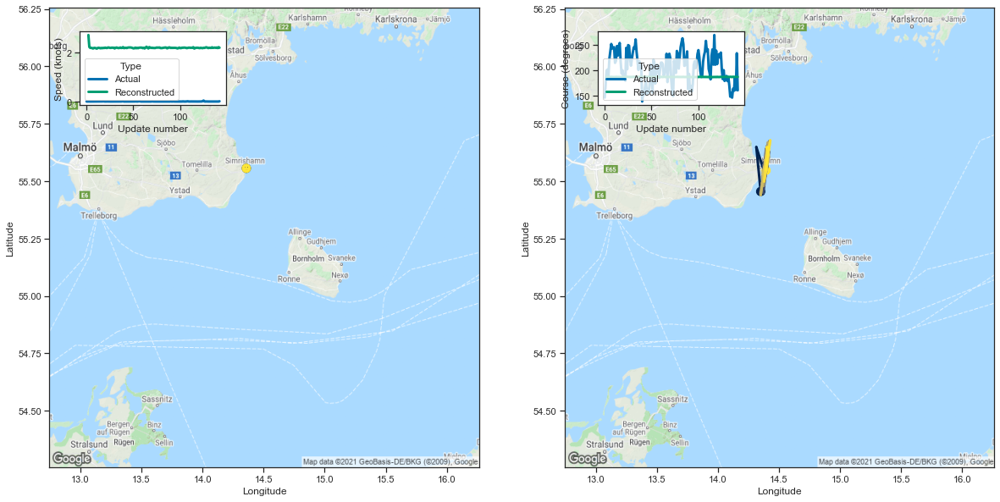

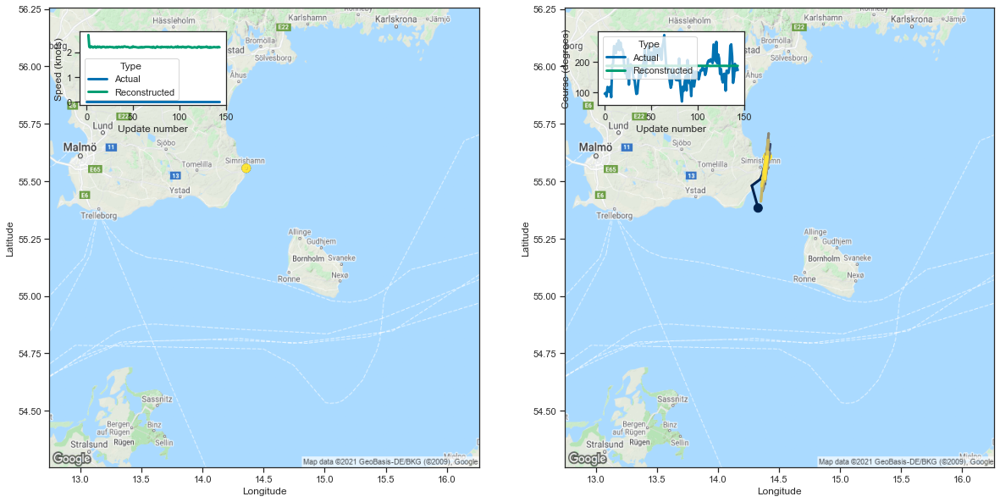

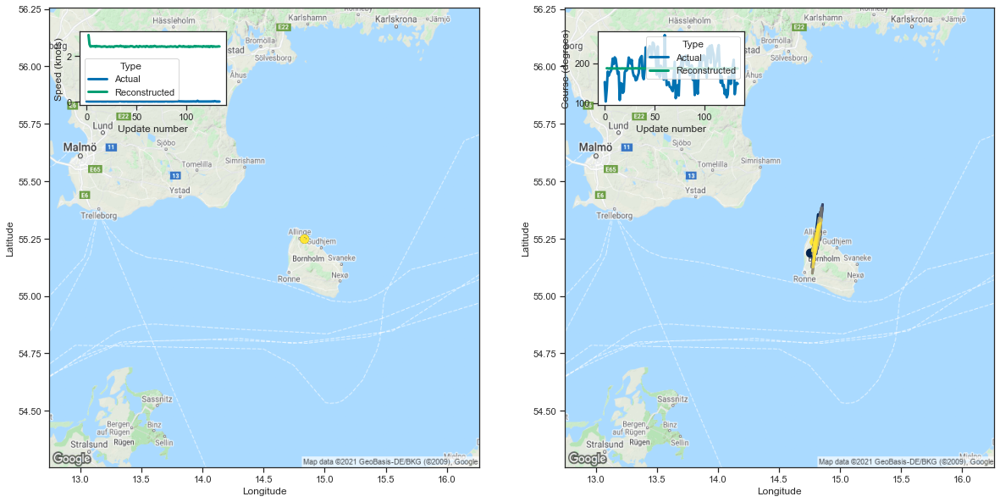

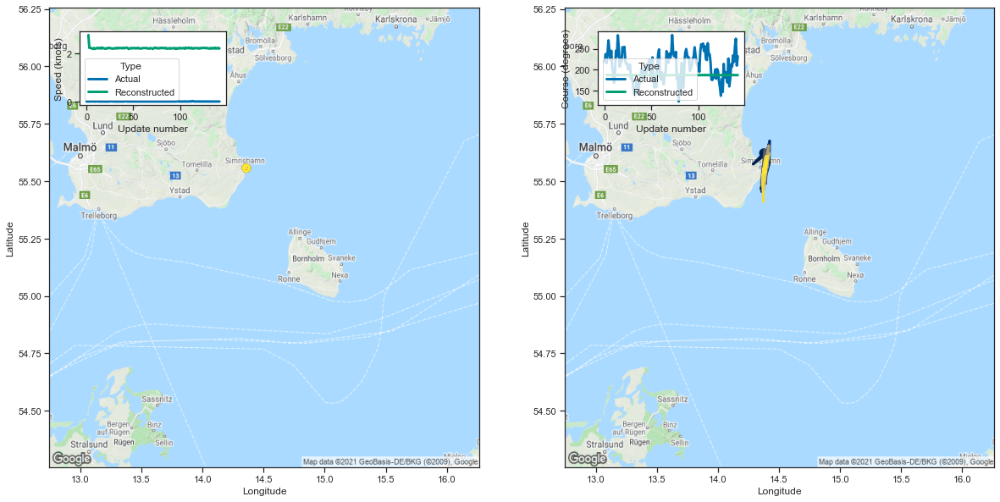

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
102,102,2204657,230069190,Fishing,141,-770.766846,-5.466432
29,29,6787151,265759000,Fishing,143,-787.615723,-5.507802
8,8,1943886,230069190,Fishing,135,-747.310547,-5.535634
95,95,6805561,265759000,Fishing,143,-792.682129,-5.543232
74,74,6962046,265759000,Fishing,143,-793.473877,-5.548768
44,44,7135380,266054000,Fishing,144,-799.639587,-5.553053
60,60,6869996,265759000,Fishing,143,-797.178101,-5.574672
25,25,7292936,266054000,Fishing,144,-805.196167,-5.591640
20,20,1961288,230069190,Fishing,134,-750.060547,-5.597467
17,17,6685896,265759000,Fishing,143,-802.573669,-5.612403


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Isotropic_Gaussian_S1_099.pth


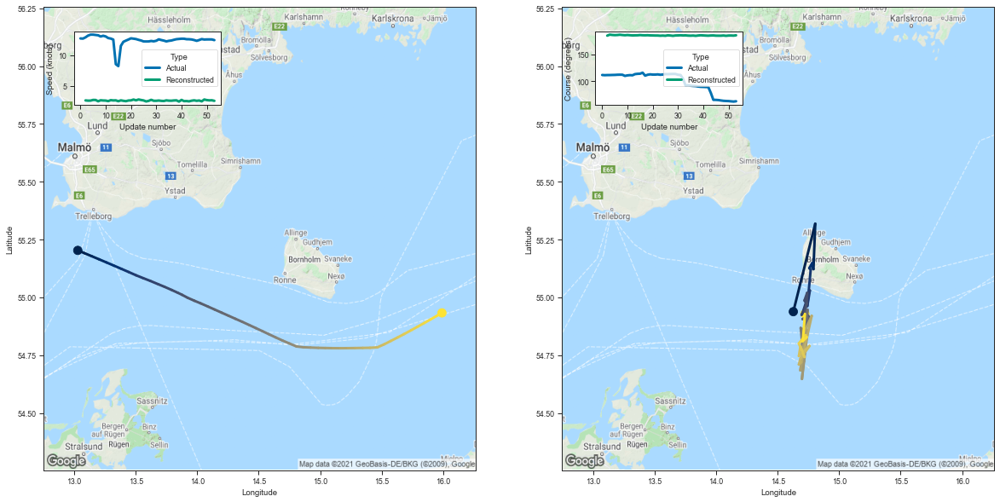

[2.597163677215576, 2.556779384613037, 2.564091682434082, 2.674832820892334]


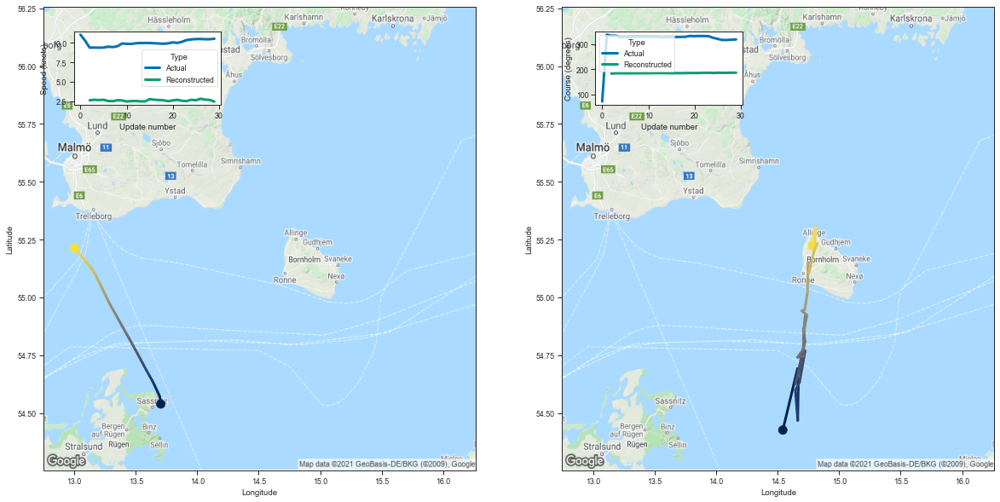

[2.5971434116363525, 2.6647443771362305, 2.6274611949920654, 2.668318748474121]


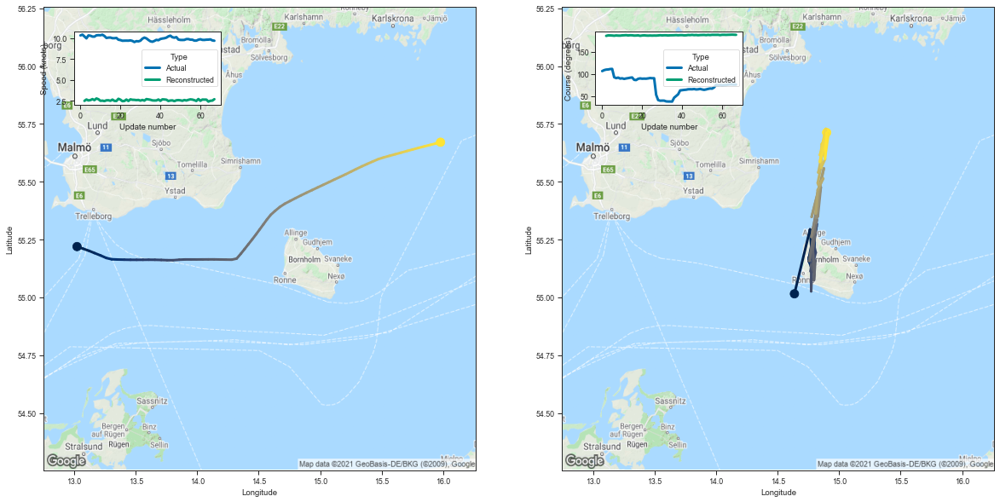

[2.507258176803589, 2.6721549034118652, 2.5587551593780518, 2.5994937419891357]


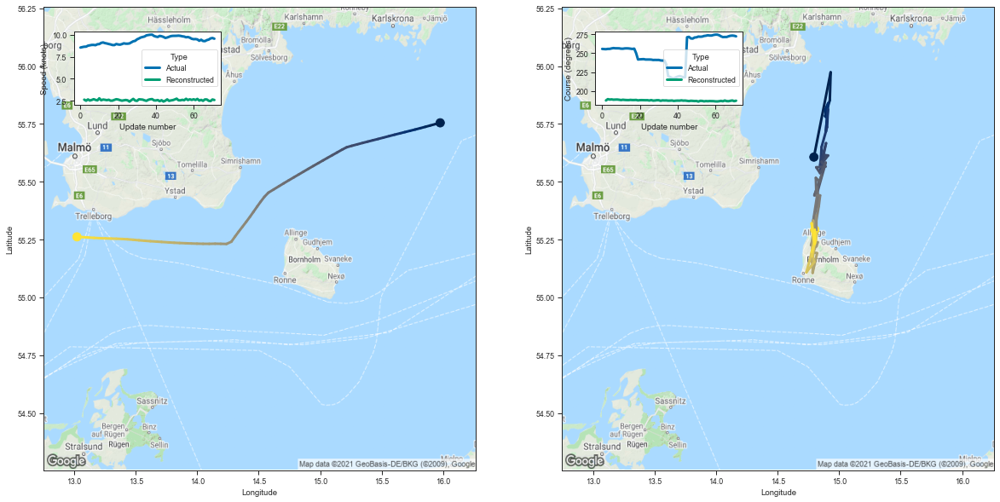

[2.649535894393921, 2.5294735431671143, 2.6726629734039307, 2.5501091480255127]


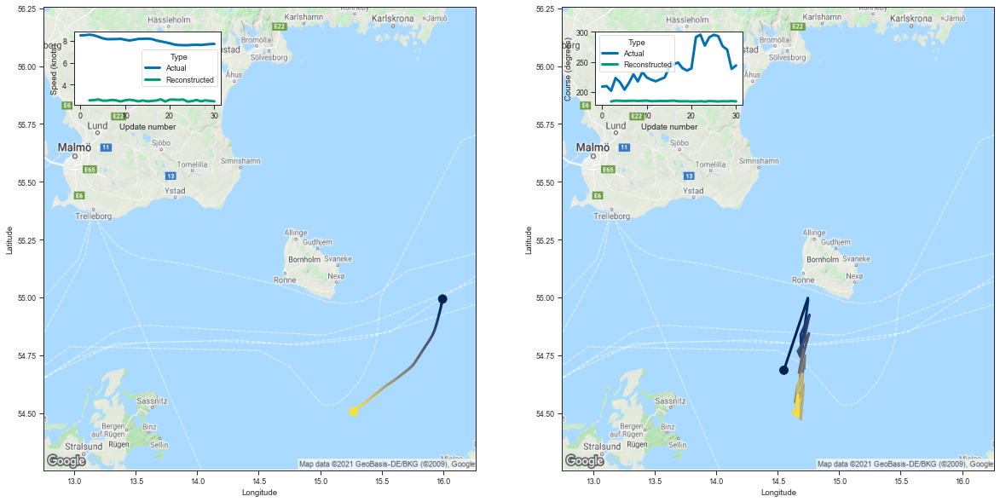

[2.5807085037231445, 2.6092073917388916, 2.6678669452667236, 2.556727409362793]


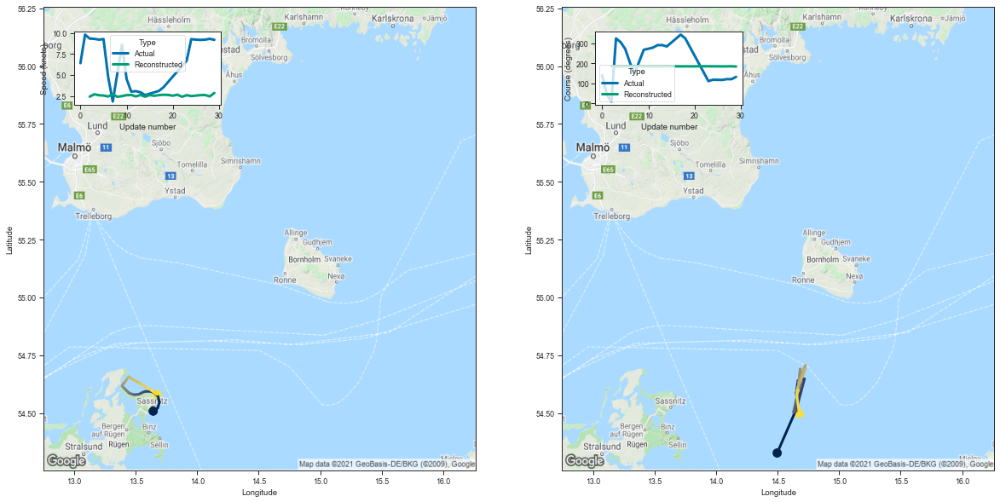

[2.4138569831848145, 2.700047254562378, 2.582270860671997, 2.545731544494629]


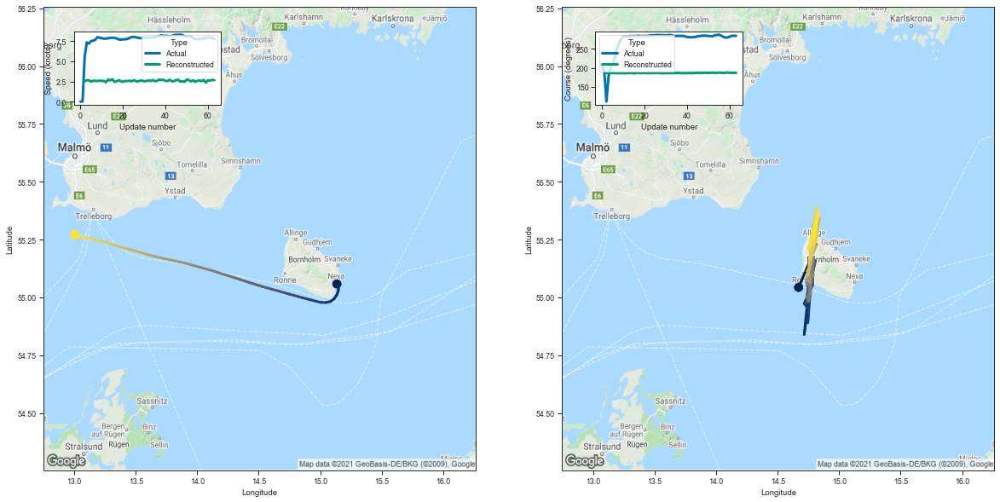

[2.518470048904419, 2.6481008529663086, 2.619701385498047, 2.4855058193206787]


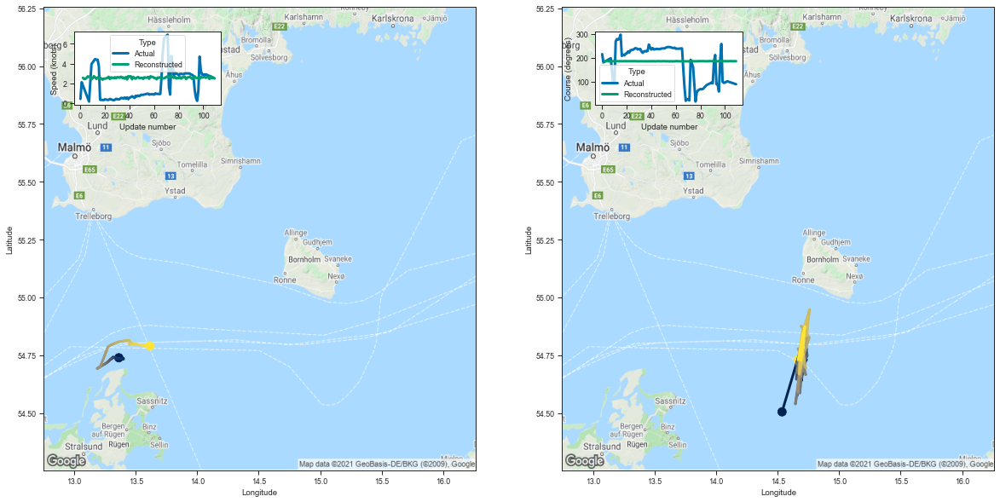

[2.5518877506256104, 2.4237513542175293, 2.4275882244110107, 2.540381908416748]


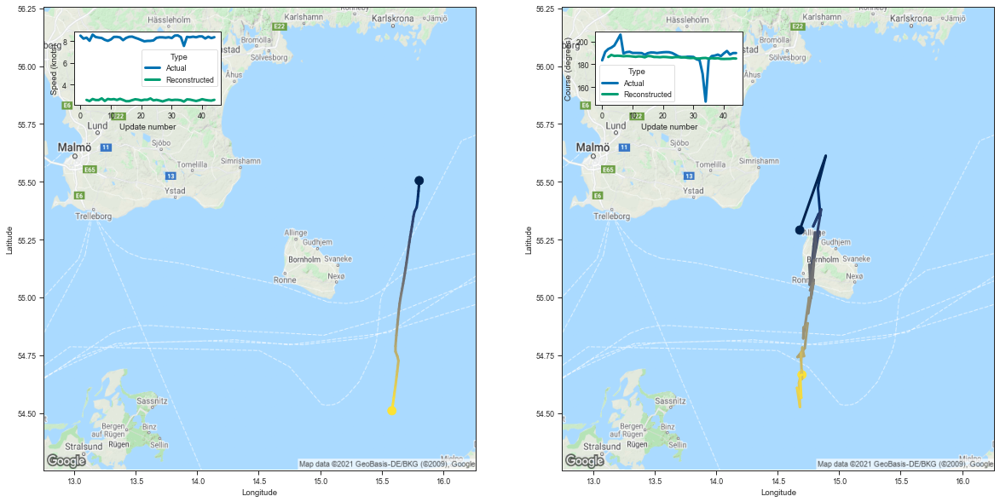

[2.5750274658203125, 2.4659342765808105, 2.6574020385742188, 2.5650734901428223]


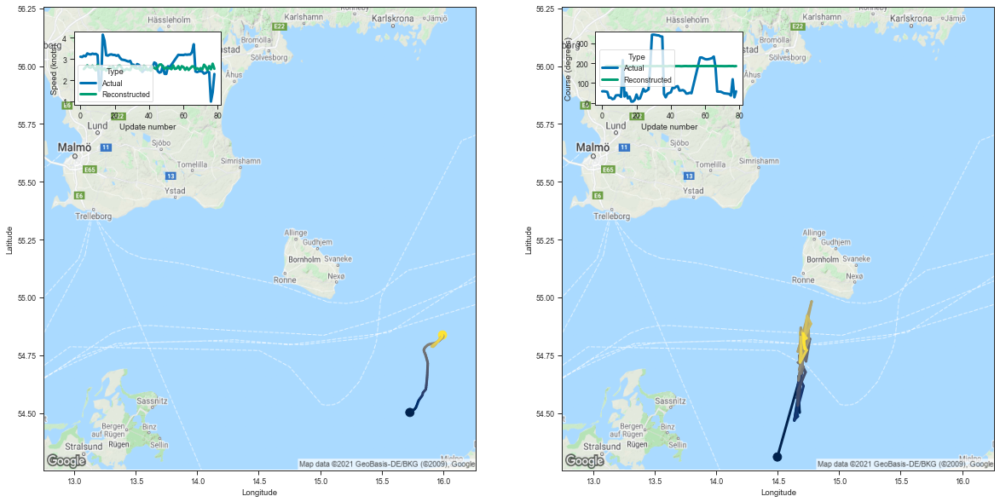

[2.523418664932251, 2.6194558143615723, 2.699763298034668, 2.6118245124816895]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
36,36,7969192,273352230,Fishing,54,-712.992432,-13.203564
101,101,1176042,211755650,Fishing,30,-395.995728,-13.199858
97,97,7993496,273513600,Fishing,68,-743.095703,-10.927878
6,6,7960421,273294000,Fishing,72,-751.477600,-10.437189
1,1,4547326,261061000,Fishing,31,-315.981049,-10.192937
73,73,1113112,211542610,Fishing,30,-303.651703,-10.121723
37,37,1615516,220339000,Fishing,64,-627.876221,-9.810566
21,21,19488,211243240,Fishing,110,-1078.531006,-9.804827
71,71,4377660,261015270,Fishing,45,-434.901520,-9.664478
59,59,4125919,261004390,Fishing,79,-756.884460,-9.580816


In [7]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Isotropic_Gaussian_lr5e-05.pth


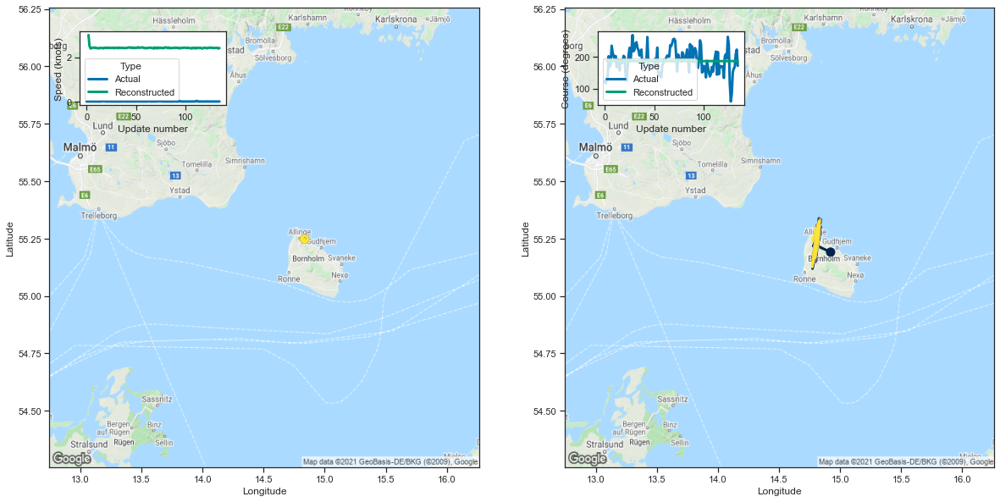

[3.0102221965789795, 2.517970561981201, 2.401482105255127, 2.410270929336548]


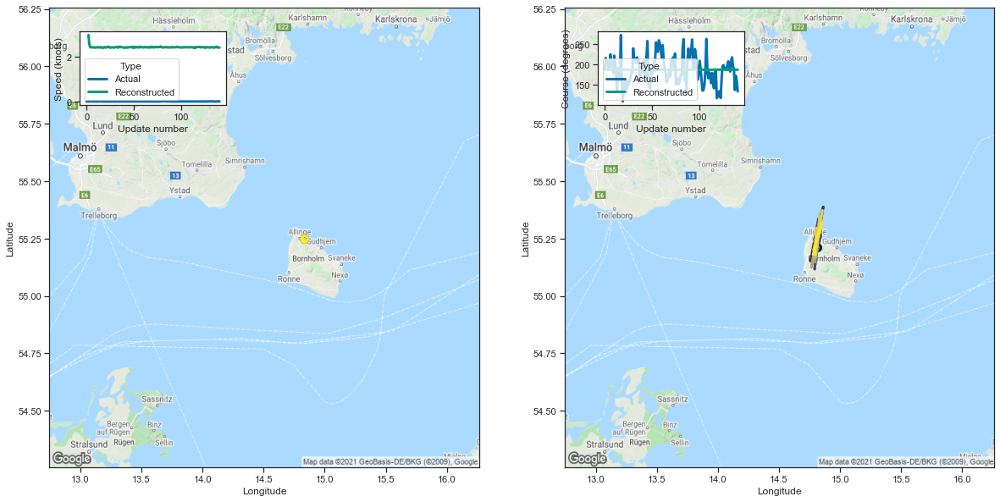

[2.9725308418273926, 2.5453033447265625, 2.4201881885528564, 2.4286508560180664]


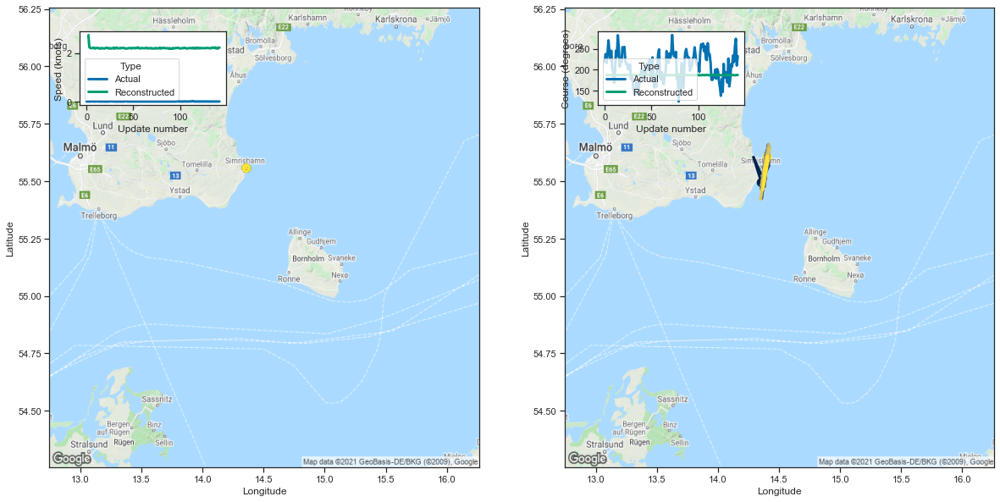

[2.749847412109375, 2.2445454597473145, 2.2168257236480713, 2.2002148628234863]


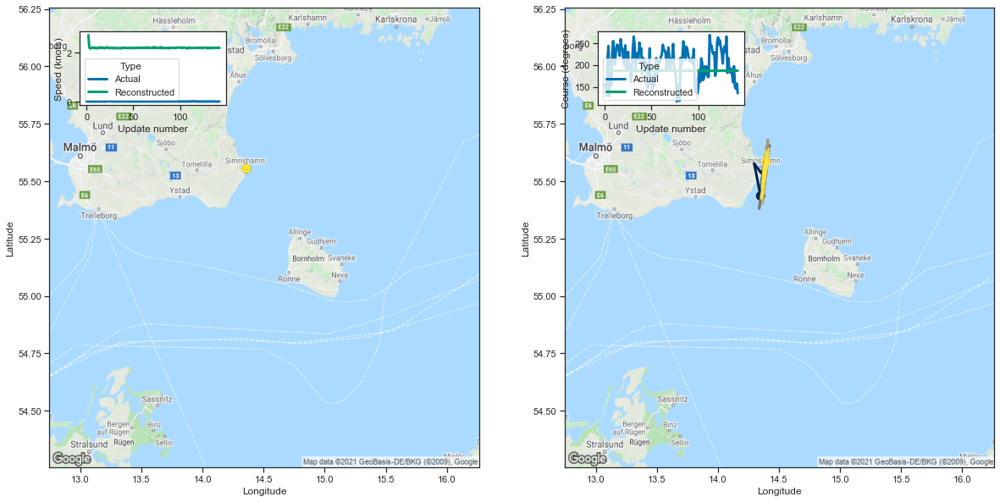

[2.73517107963562, 2.2217602729797363, 2.1810202598571777, 2.2046473026275635]


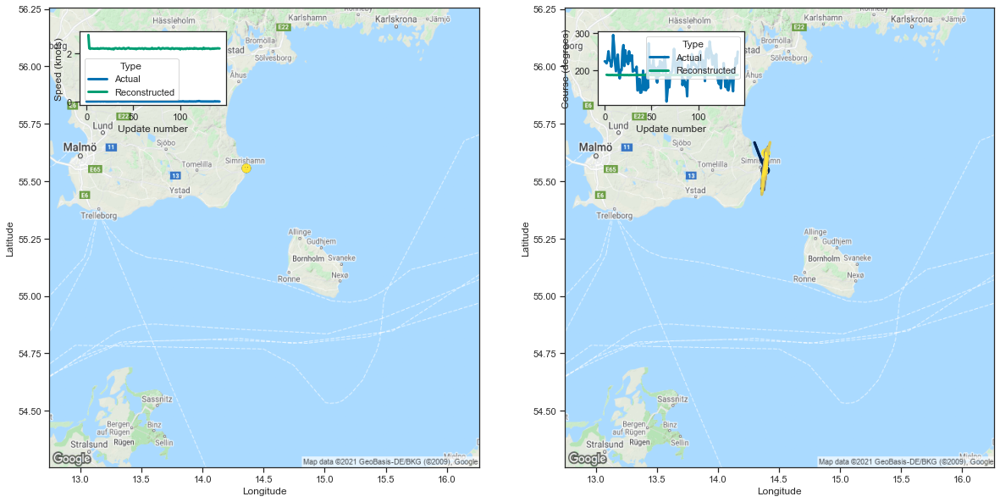

[2.768503427505493, 2.2148330211639404, 2.1941487789154053, 2.2141342163085938]


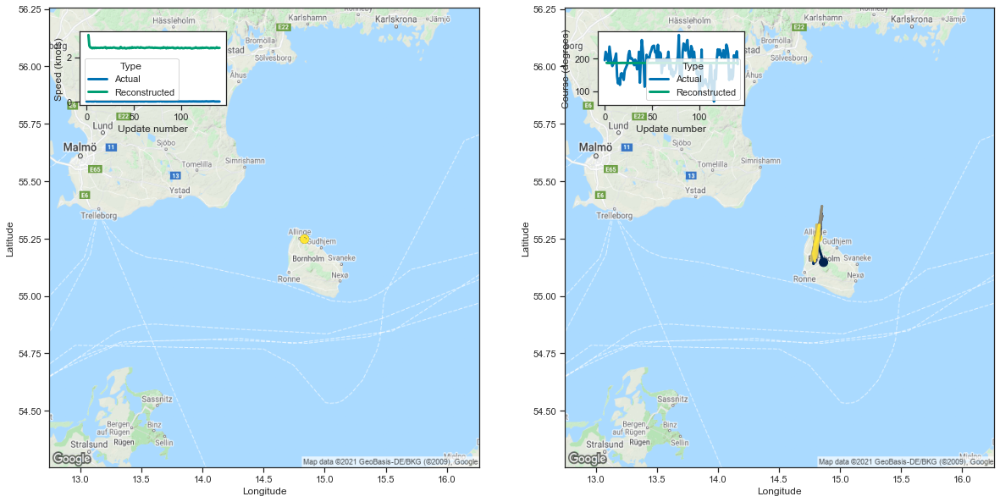

[3.0034563541412354, 2.5198099613189697, 2.443037509918213, 2.4286677837371826]


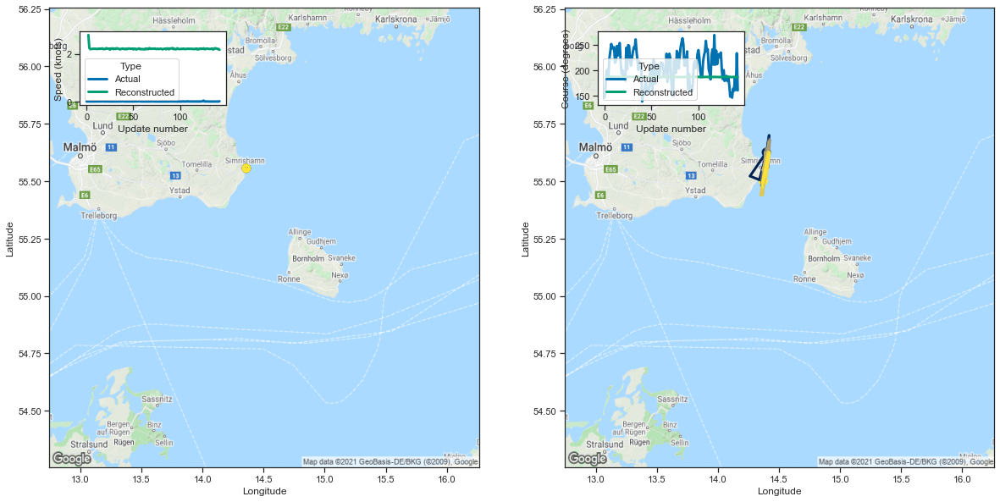

[2.785403251647949, 2.240849494934082, 2.193451166152954, 2.2009007930755615]


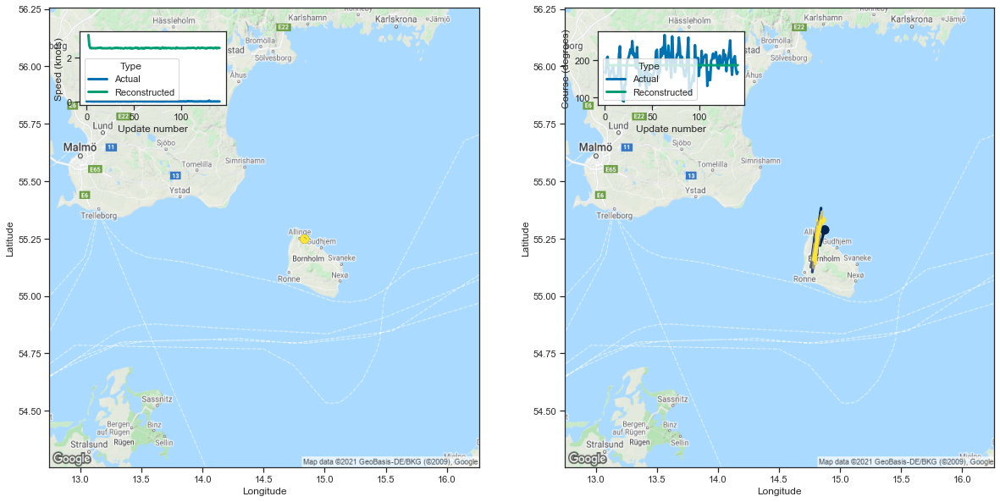

[3.018319606781006, 2.534019947052002, 2.428062915802002, 2.4142403602600098]


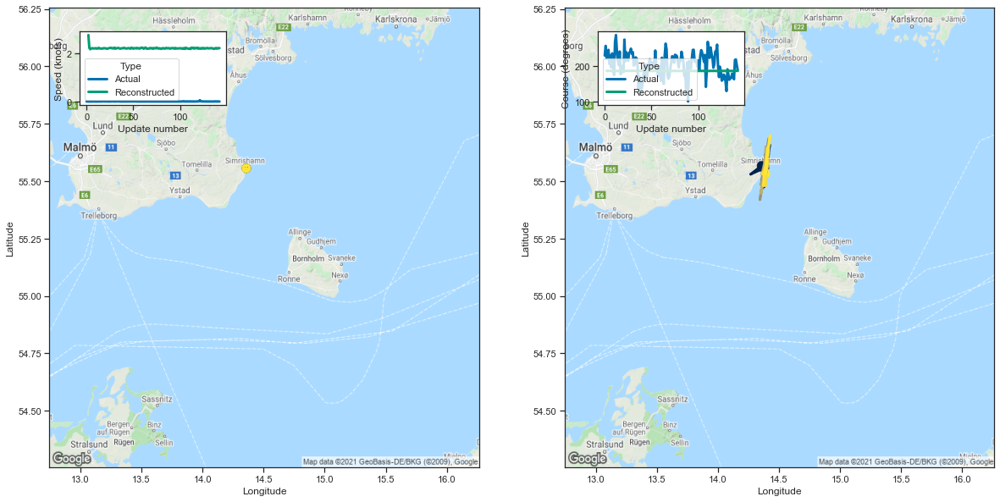

[2.757833957672119, 2.2256970405578613, 2.1691884994506836, 2.203545093536377]


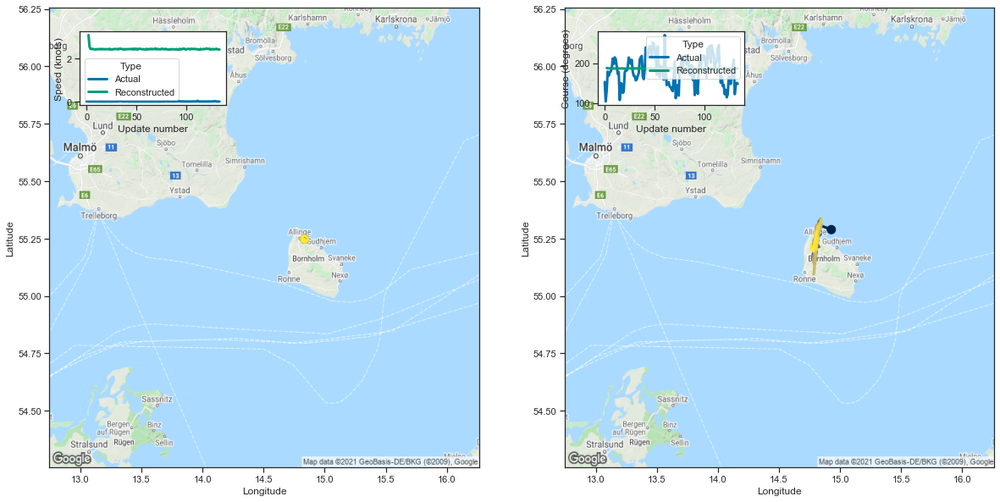

[3.082245111465454, 2.5423786640167236, 2.4363813400268555, 2.4335594177246094]


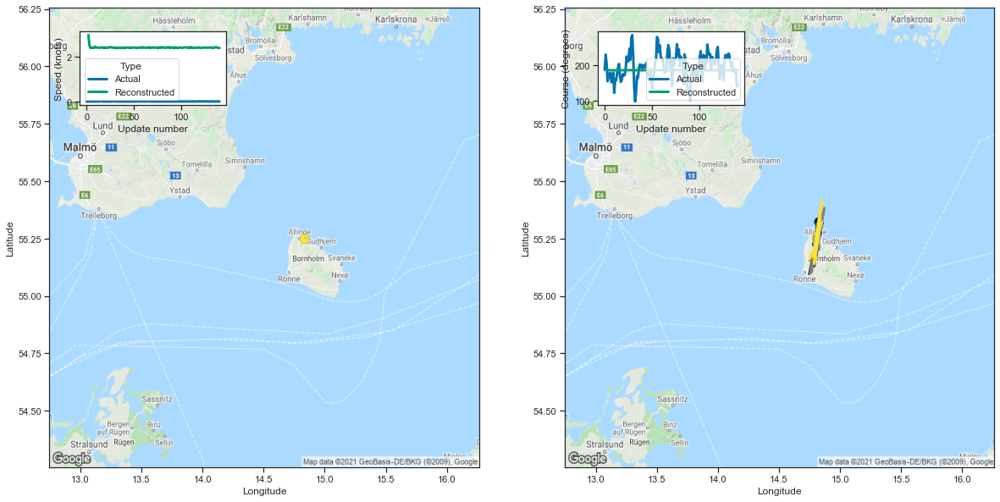

[2.995926856994629, 2.5534439086914062, 2.4225783348083496, 2.411170482635498]


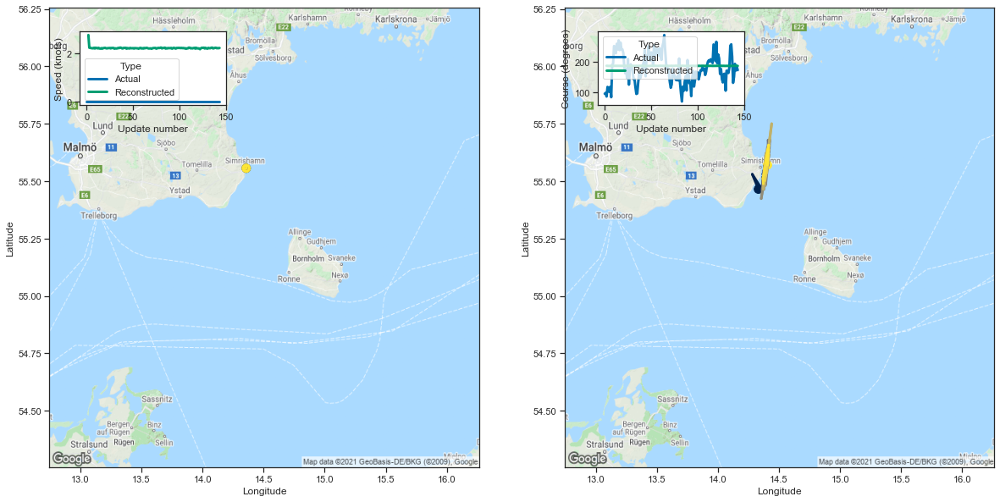

[2.7519736289978027, 2.225346088409424, 2.2245442867279053, 2.2086305618286133]


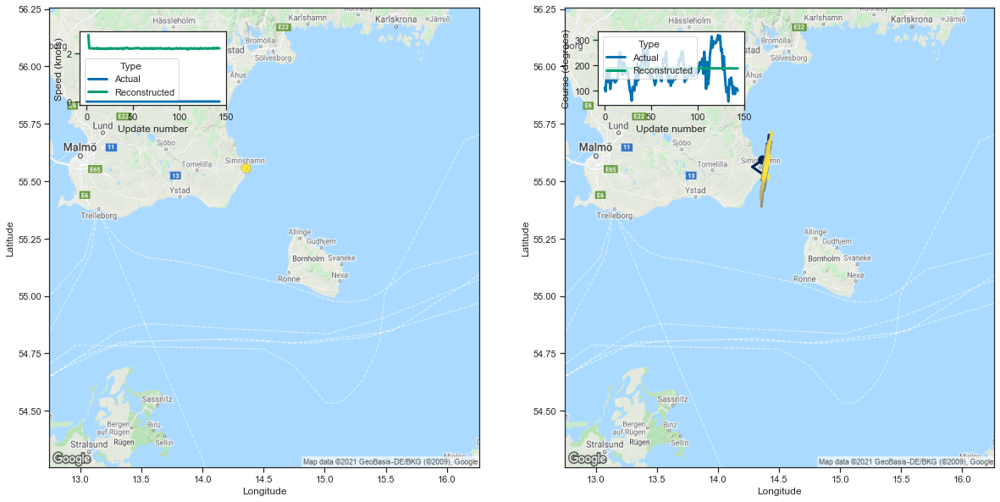

[2.7692105770111084, 2.2239885330200195, 2.2104218006134033, 2.216536521911621]


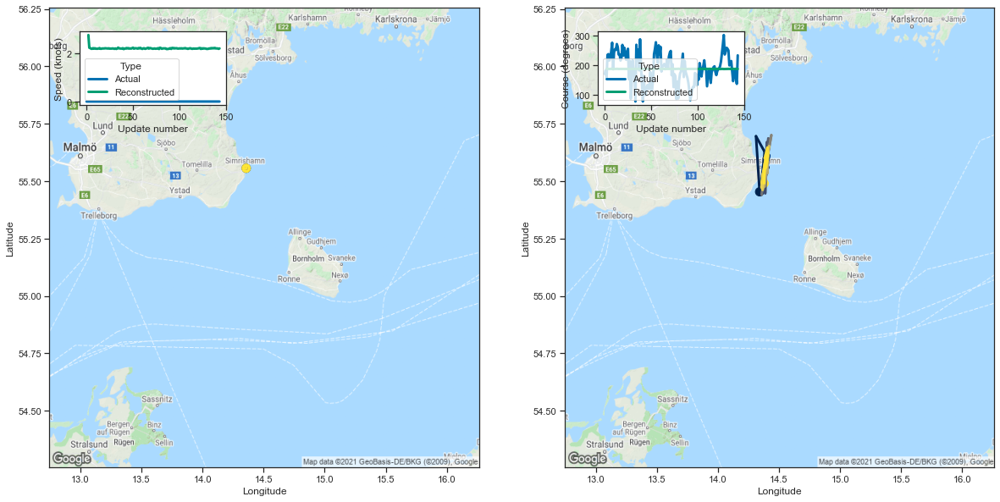

[2.766343832015991, 2.2377467155456543, 2.2232065200805664, 2.195578098297119]


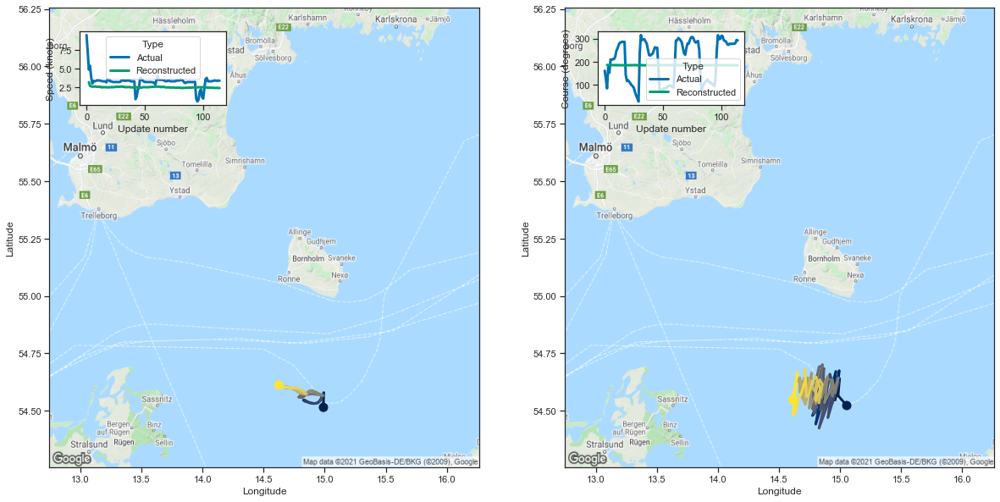

[3.180164337158203, 2.6739256381988525, 2.628113269805908, 2.5755181312561035]


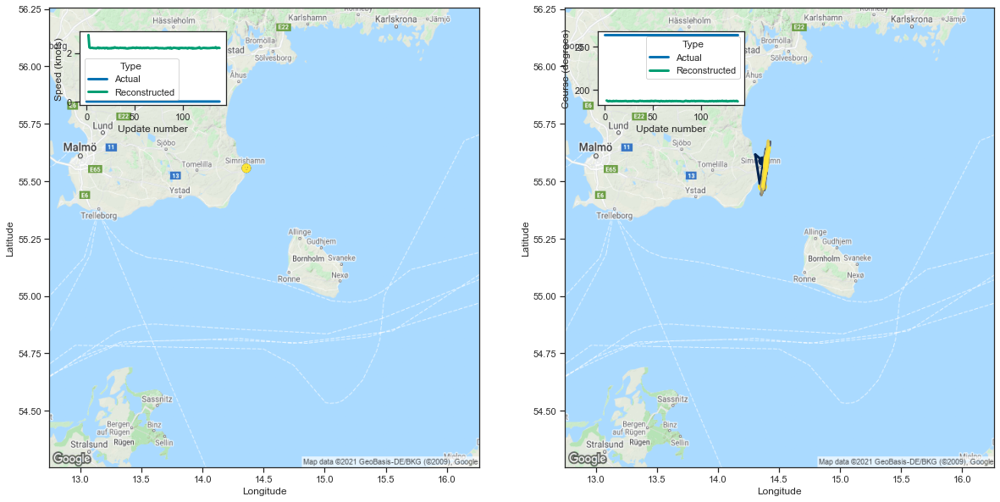

[2.7433974742889404, 2.2354657649993896, 2.2083027362823486, 2.2141809463500977]


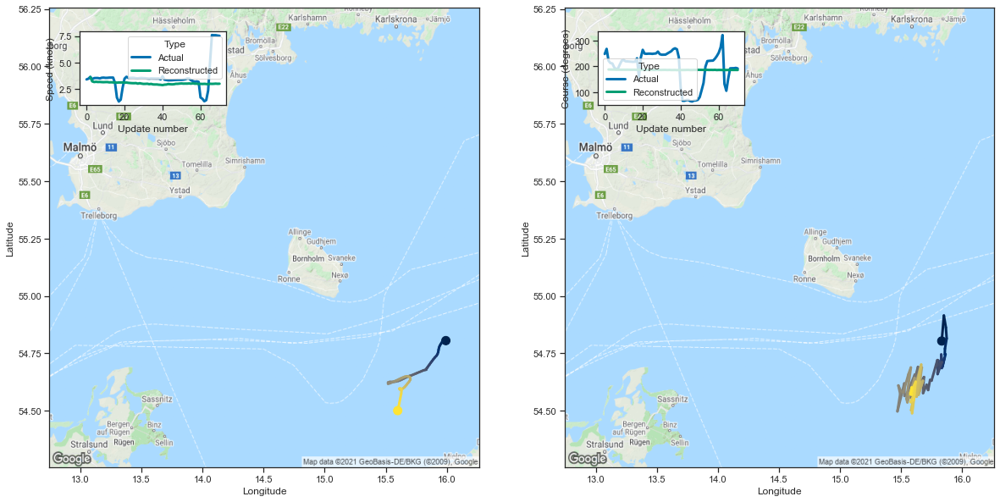

[3.6421608924865723, 3.2442665100097656, 3.1838929653167725, 3.205066442489624]


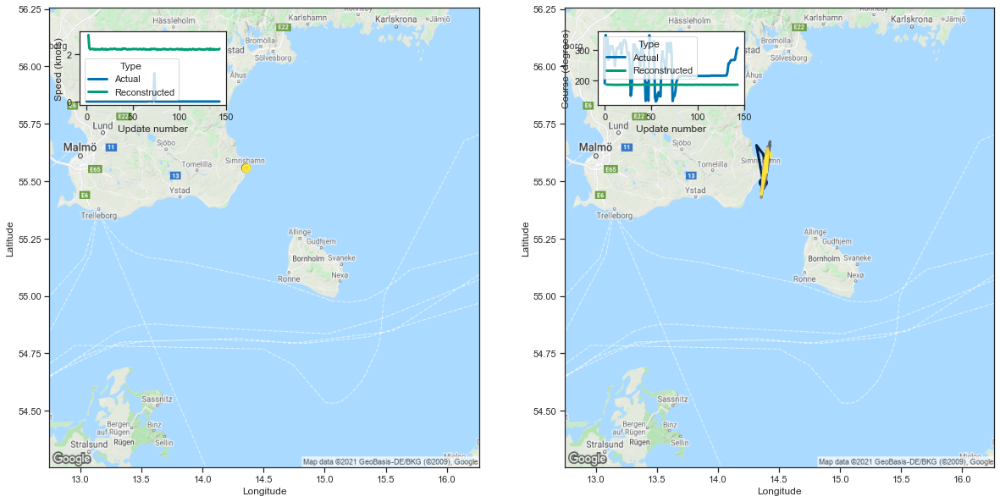

[2.807389497756958, 2.2596380710601807, 2.204364538192749, 2.214524984359741]


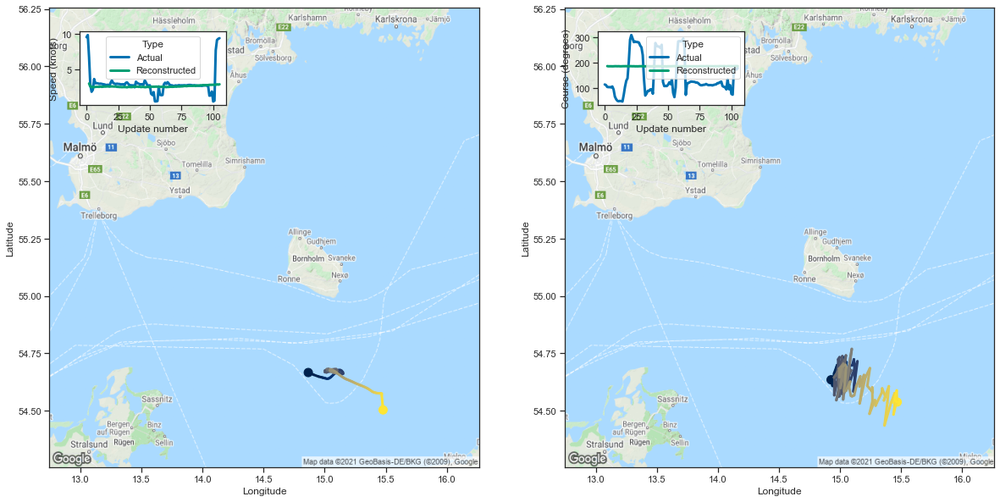

[3.082540988922119, 2.662856101989746, 2.5632617473602295, 2.5942013263702393]


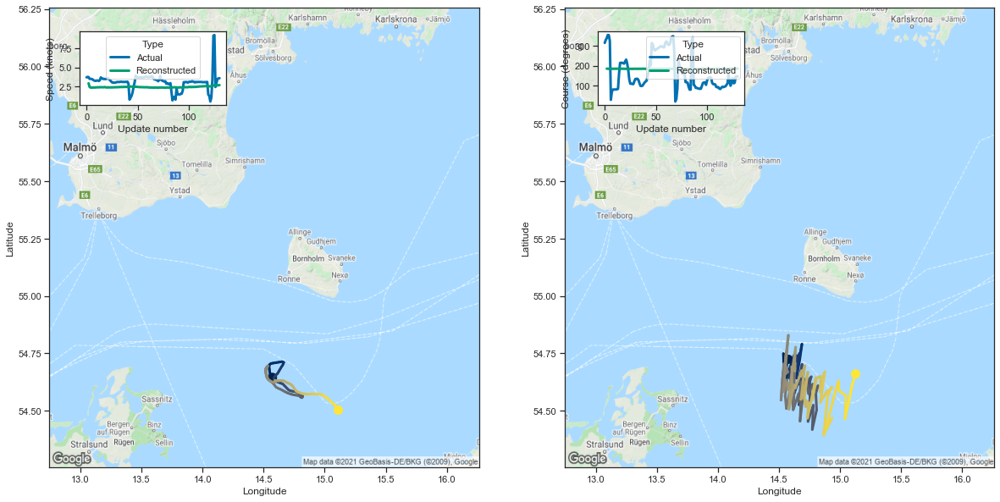

[2.9301037788391113, 2.4450173377990723, 2.3654069900512695, 2.3573429584503174]


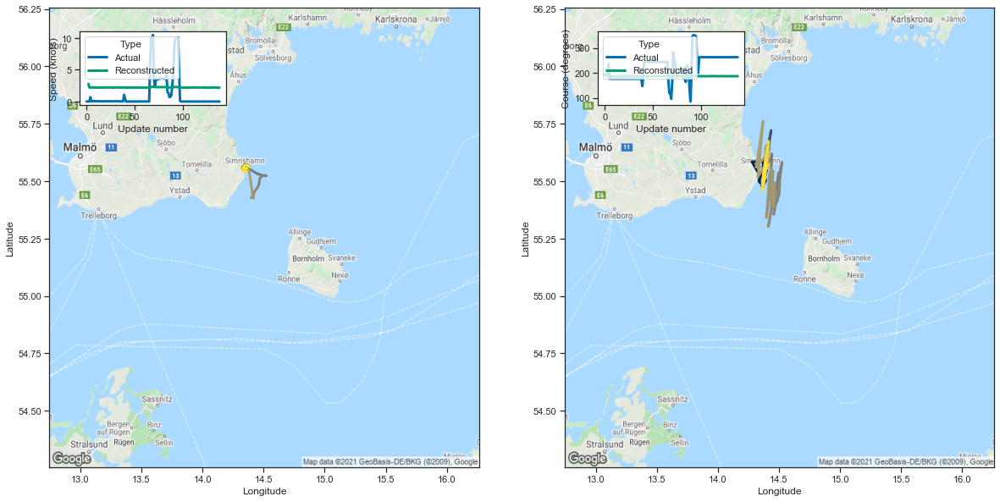

[2.780212640762329, 2.2106430530548096, 2.199841260910034, 2.201613664627075]


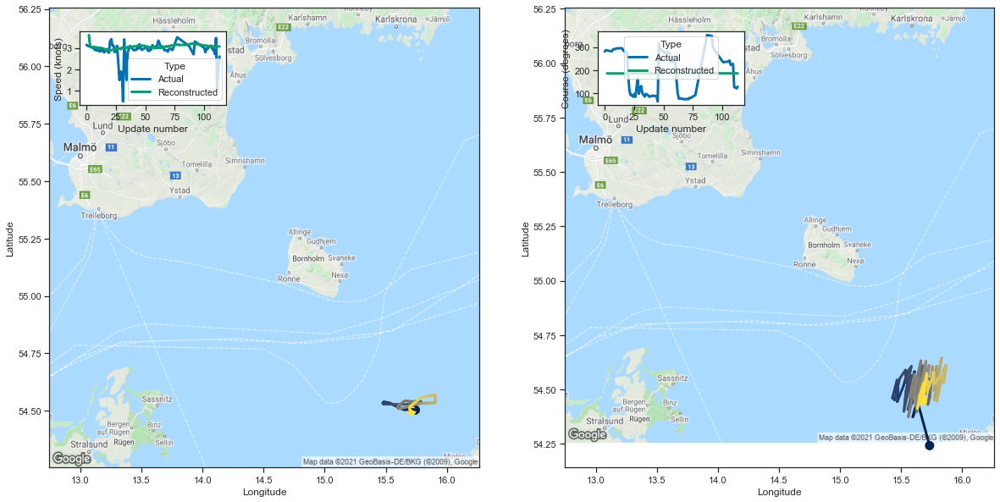

[3.6033565998077393, 3.104401111602783, 3.026078701019287, 3.047381639480591]


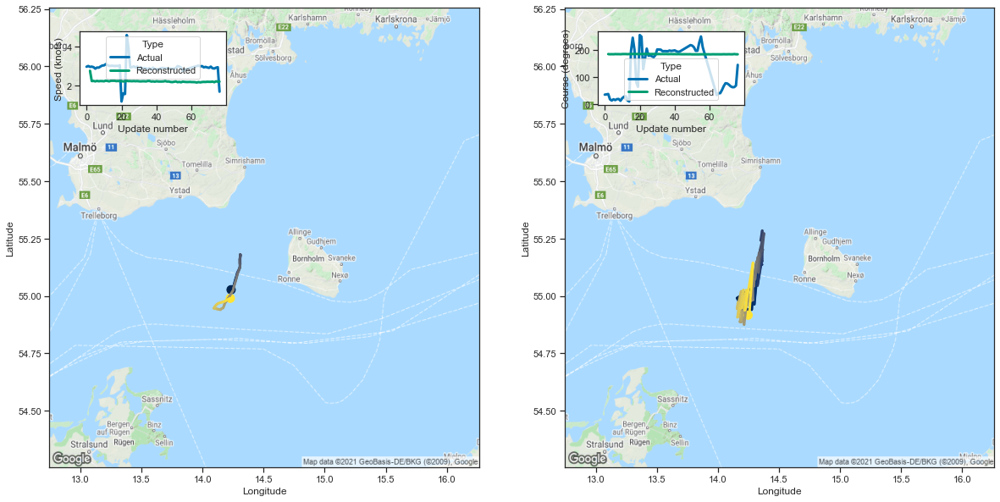

[2.7600533962249756, 2.2291531562805176, 2.237802028656006, 2.2146520614624023]


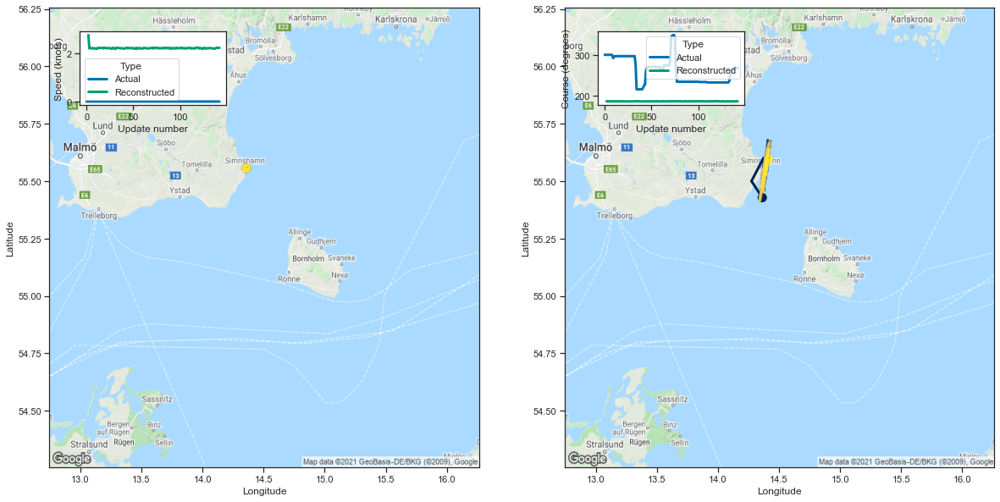

[2.7503700256347656, 2.1985530853271484, 2.2171237468719482, 2.204437255859375]


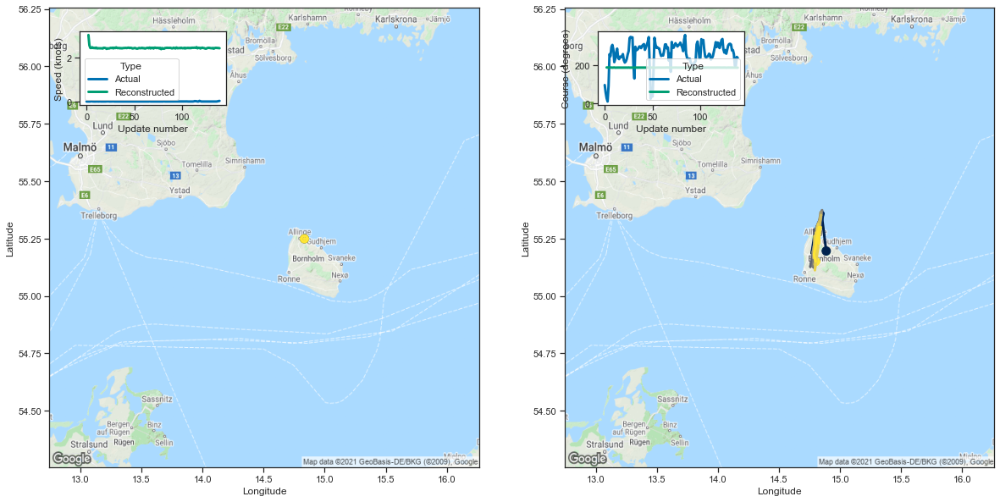

[3.016113519668579, 2.5496368408203125, 2.4306640625, 2.4265308380126953]


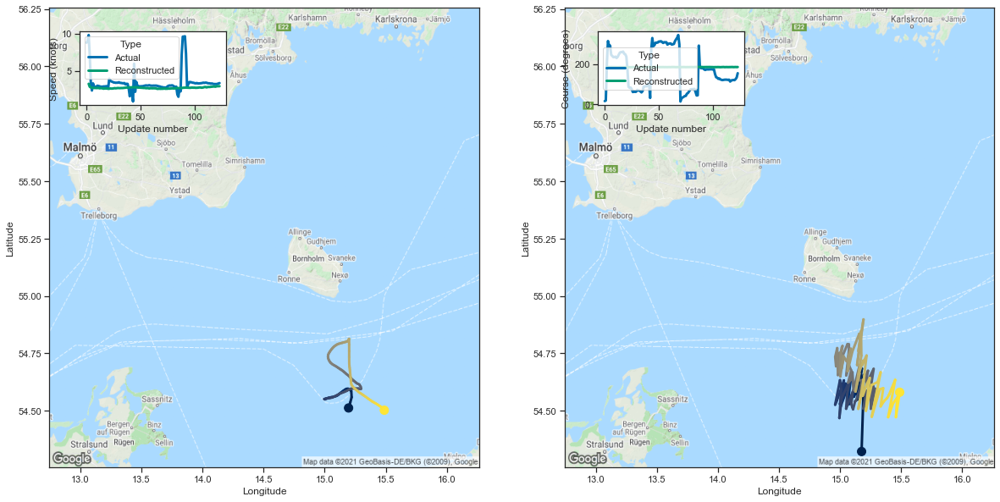

[3.248605728149414, 2.841377019882202, 2.769740104675293, 2.7143144607543945]


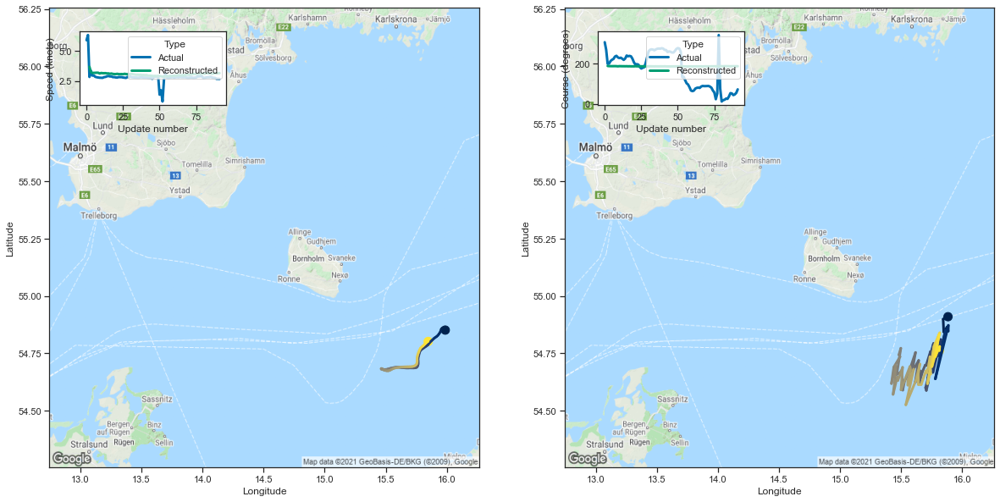

[3.6811017990112305, 3.246488332748413, 3.1645140647888184, 3.1760382652282715]


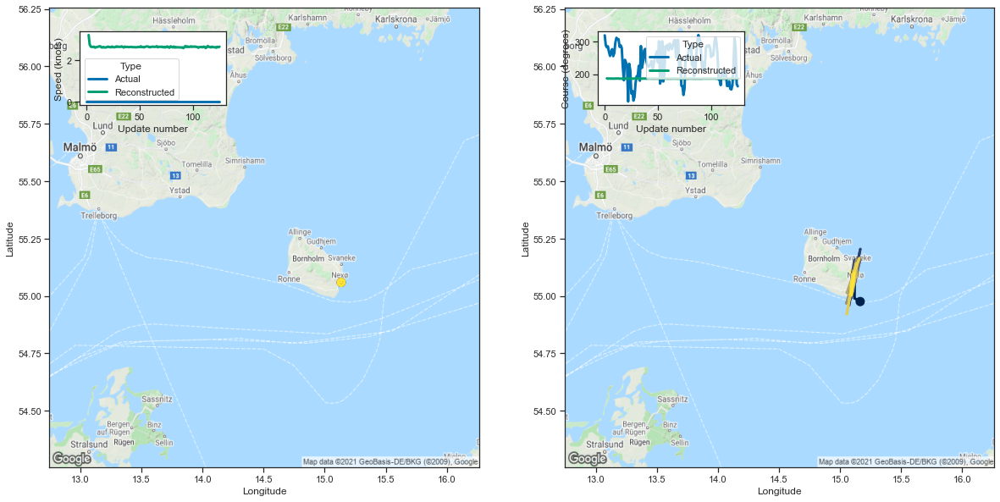

[3.198979616165161, 2.7342207431793213, 2.639526128768921, 2.626509189605713]


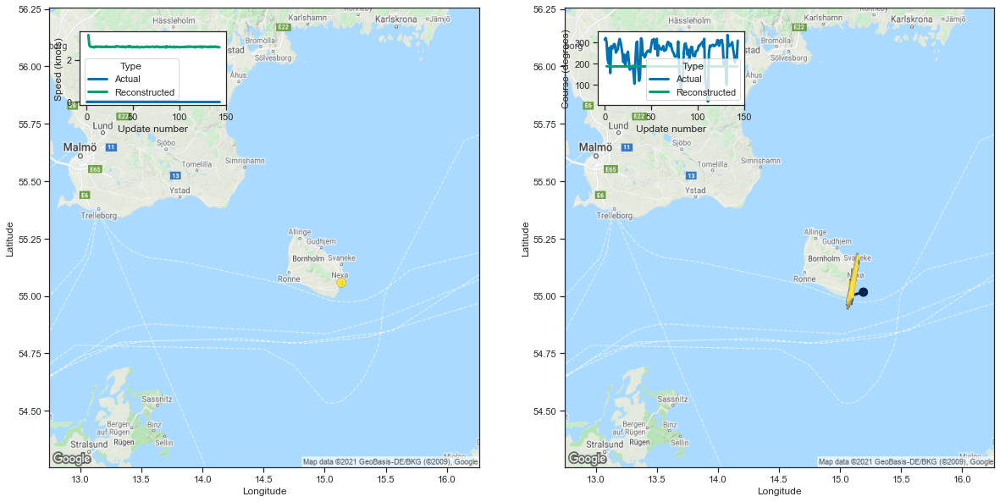

[3.188603401184082, 2.701148748397827, 2.630579710006714, 2.630155086517334]


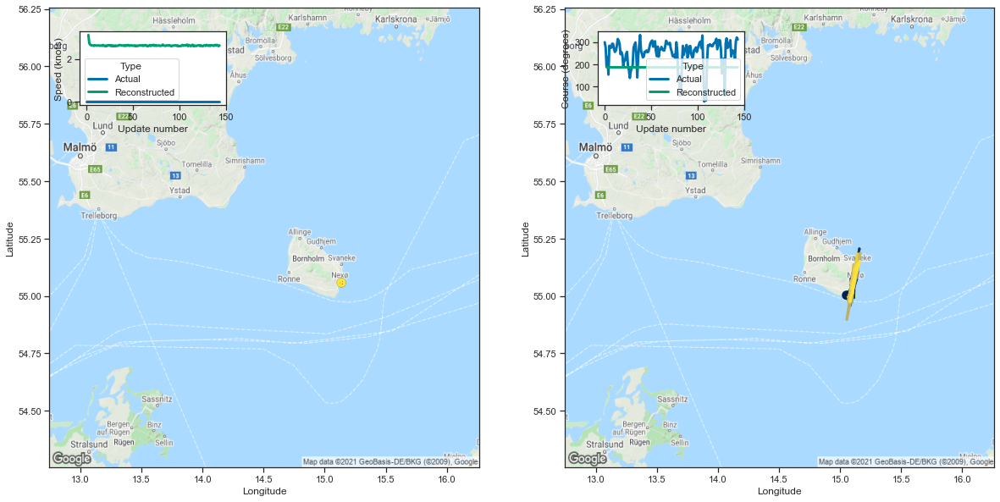

[3.116739273071289, 2.729541778564453, 2.661189079284668, 2.6365740299224854]


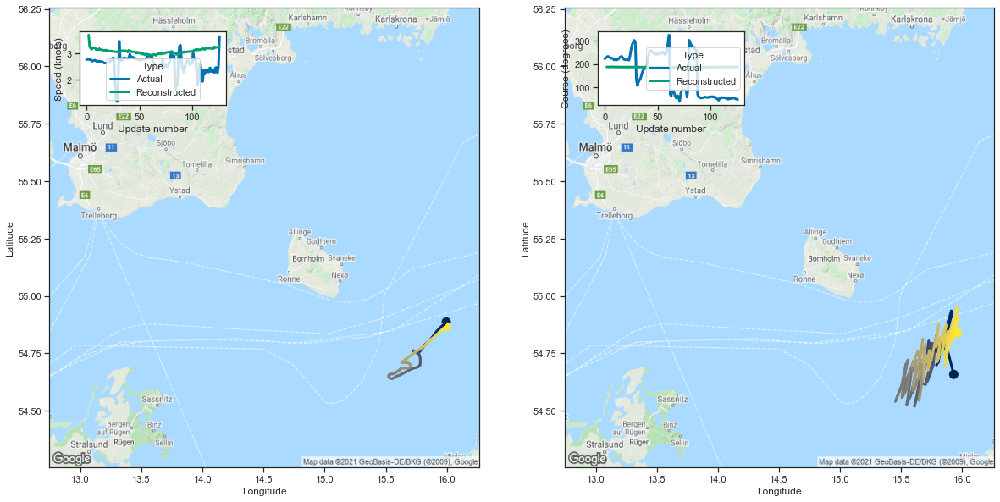

[3.6987714767456055, 3.2517478466033936, 3.188755512237549, 3.1588900089263916]


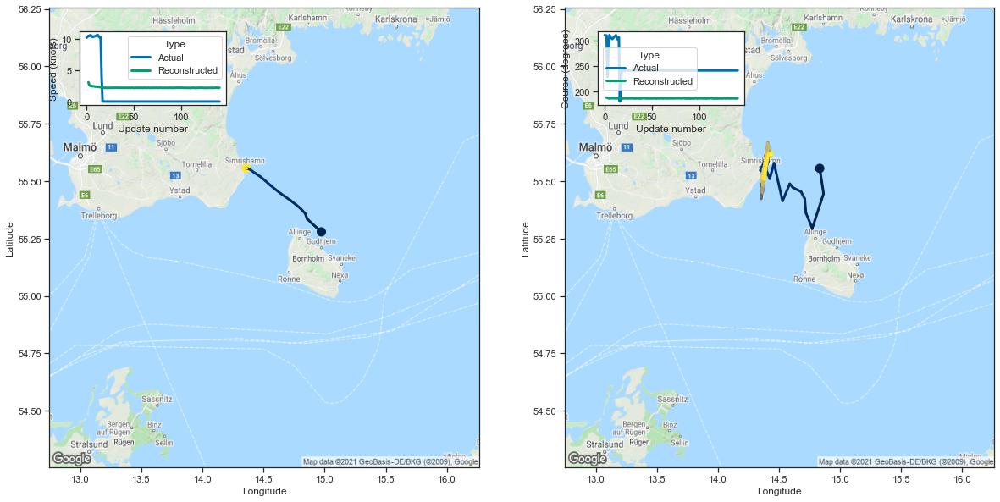

[3.096074342727661, 2.632068157196045, 2.5248961448669434, 2.5093905925750732]


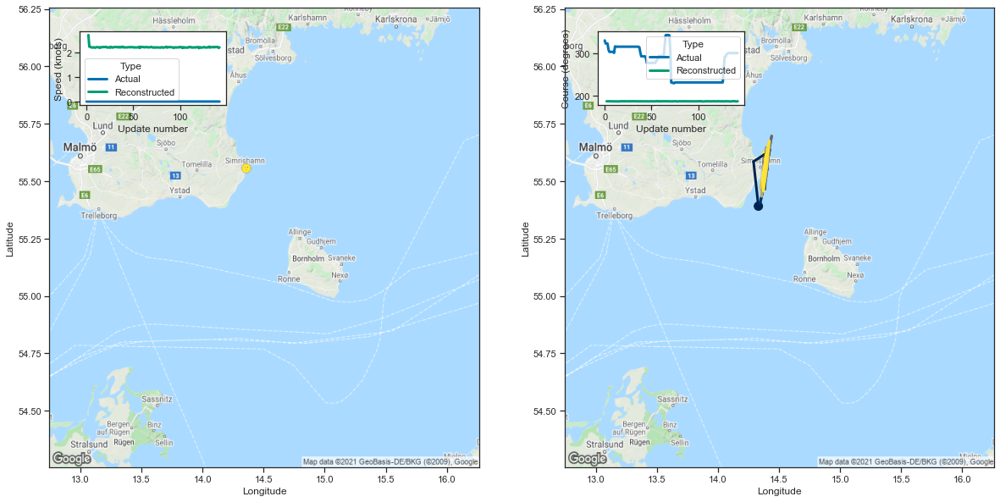

[2.7057621479034424, 2.2292449474334717, 2.228374719619751, 2.205031156539917]


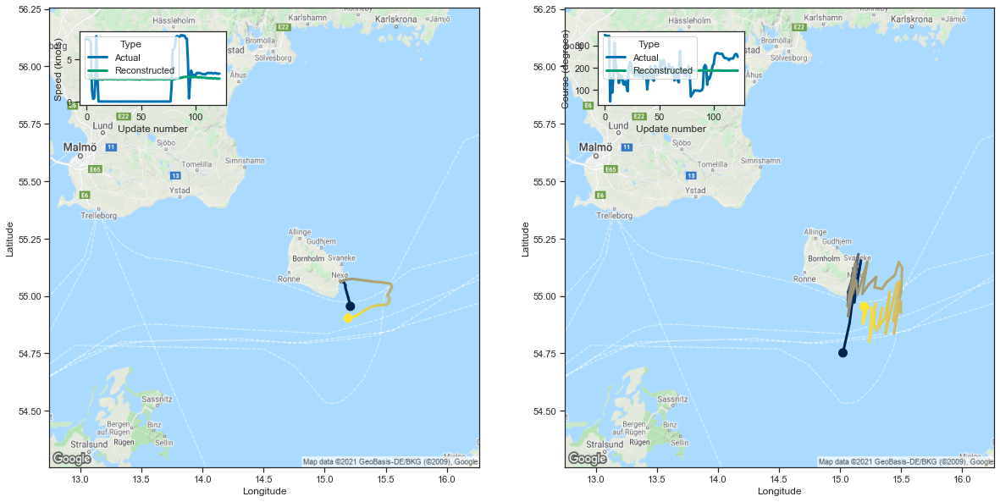

[3.1340224742889404, 2.7371935844421387, 2.6769580841064453, 2.6887412071228027]


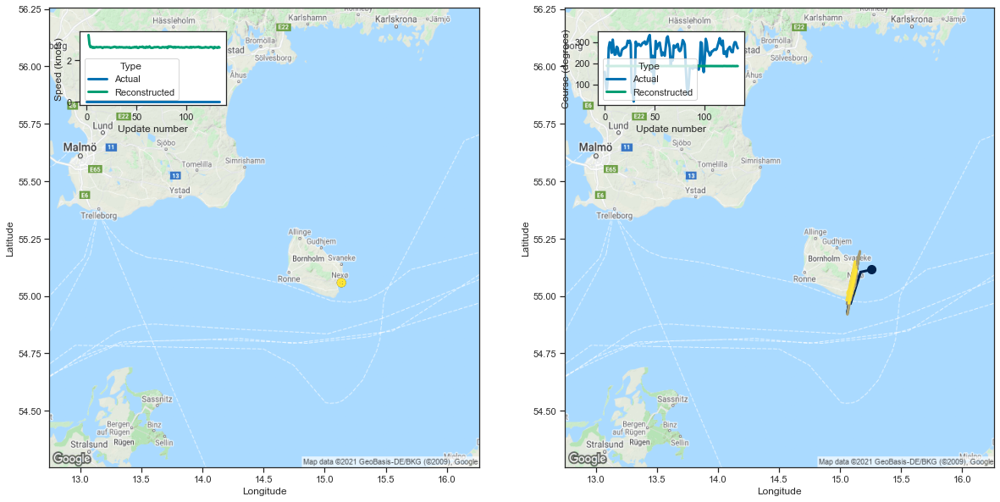

[3.214271306991577, 2.761863946914673, 2.6291537284851074, 2.6518516540527344]


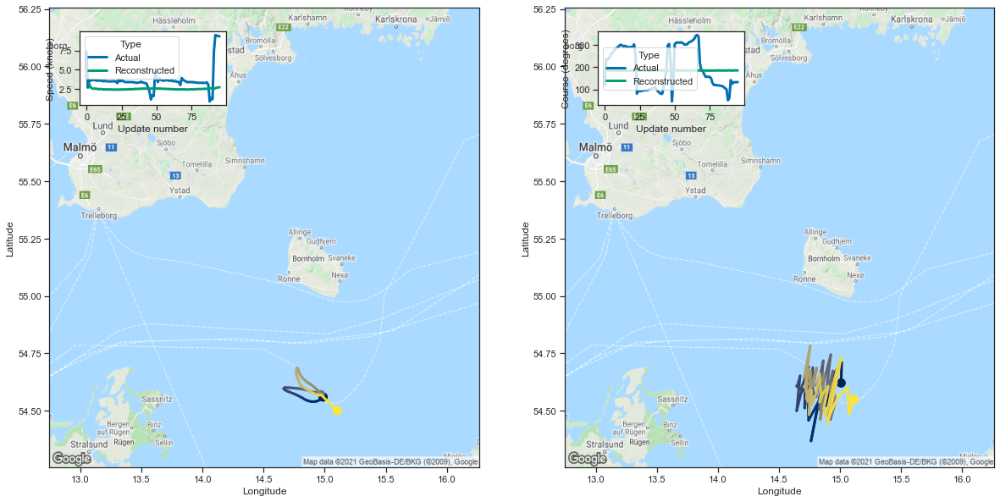

[3.1317310333251953, 2.698620080947876, 2.583249807357788, 2.5319766998291016]


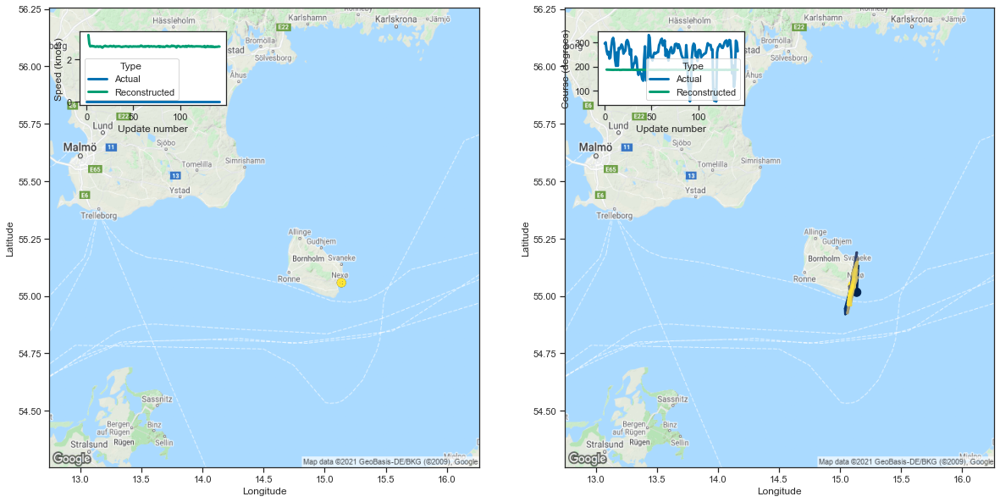

[3.1657543182373047, 2.751854419708252, 2.624448299407959, 2.631021738052368]


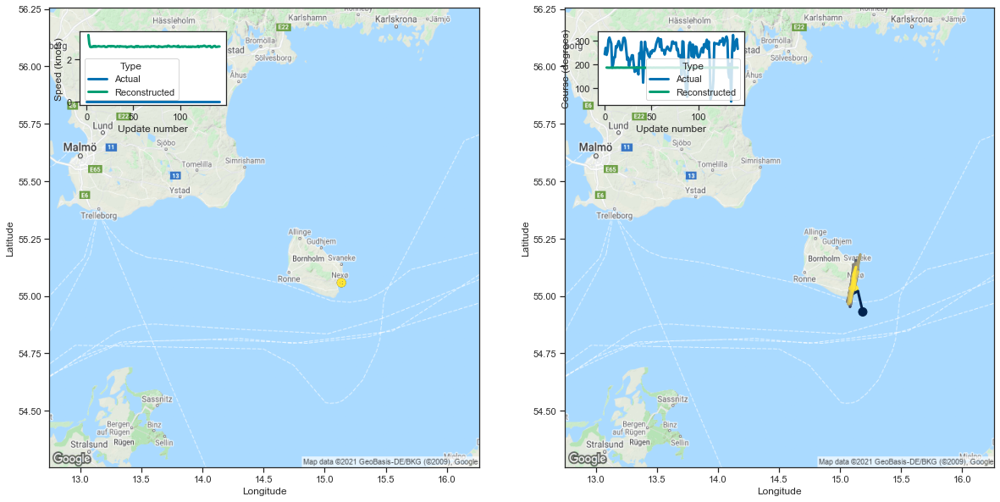

[3.1735565662384033, 2.7527694702148438, 2.611360549926758, 2.59670090675354]


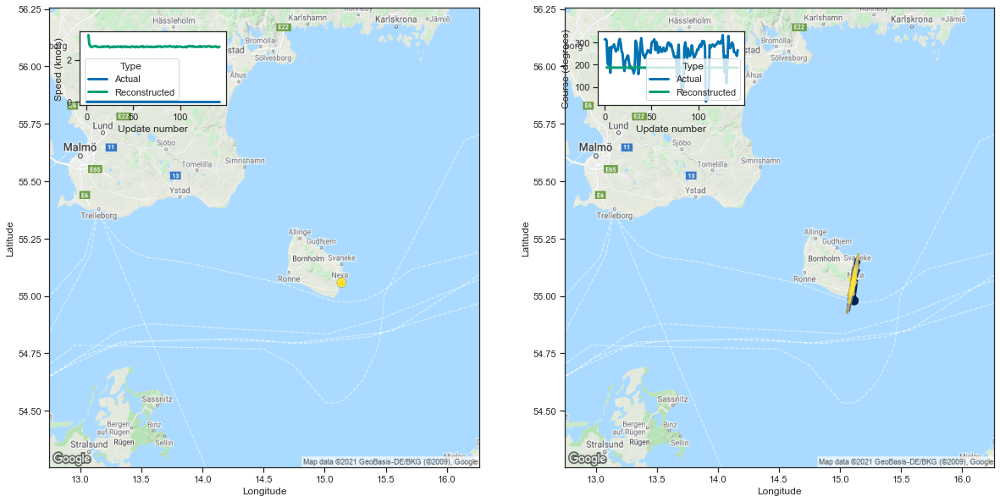

[3.1810567378997803, 2.739398717880249, 2.660505771636963, 2.603182792663574]


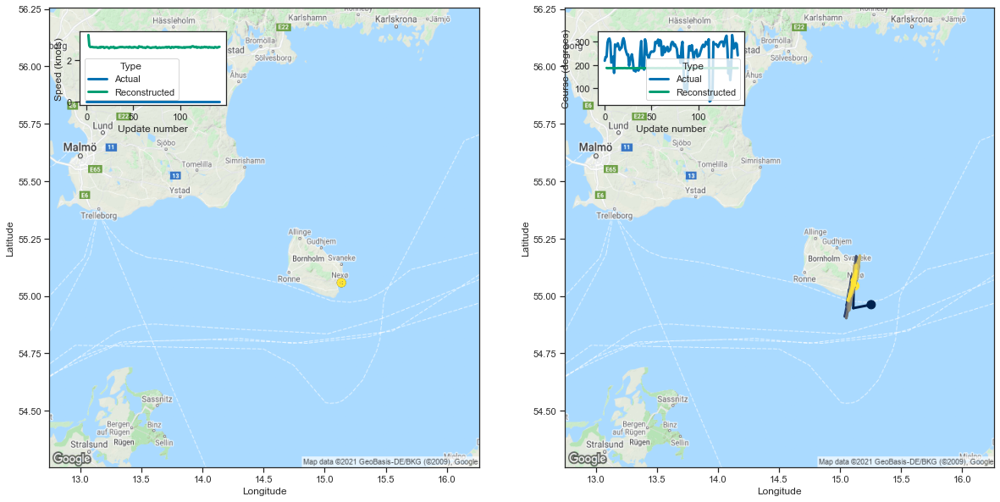

[3.216475009918213, 2.703450918197632, 2.638317584991455, 2.6390531063079834]


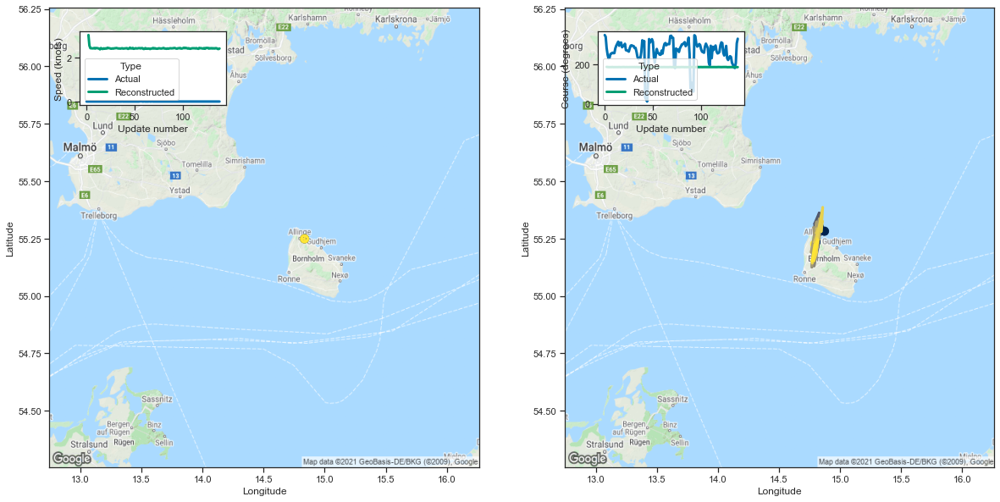

[3.034888505935669, 2.5535521507263184, 2.435285806655884, 2.42895245552063]


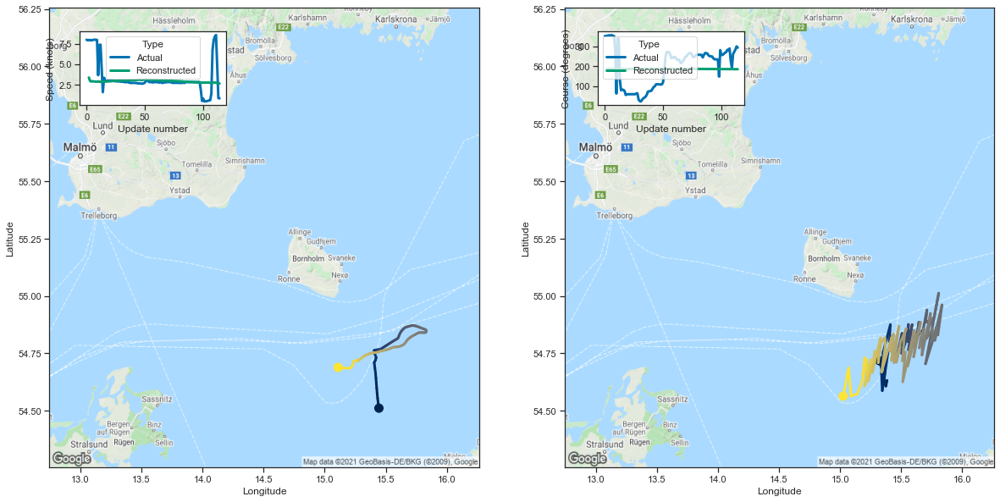

[3.357302665710449, 2.940267324447632, 2.869607448577881, 2.8997836112976074]


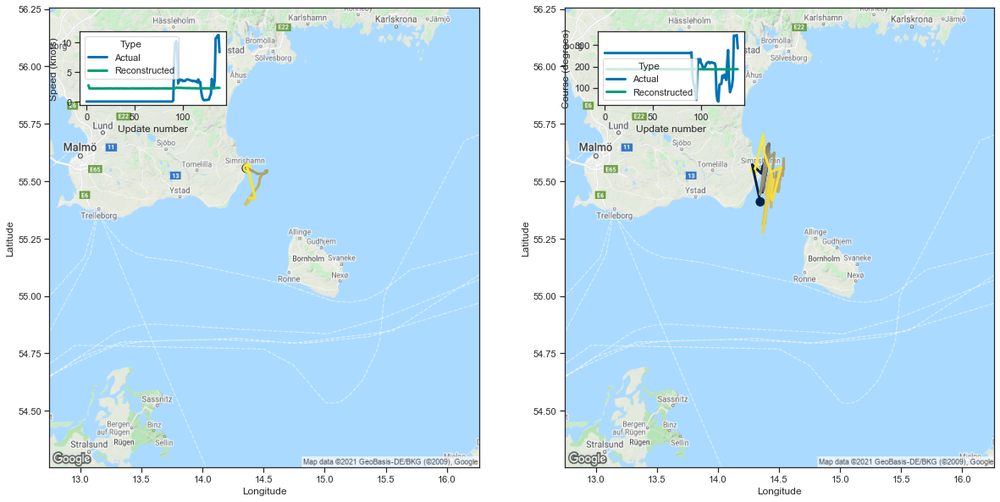

[2.754551649093628, 2.2200582027435303, 2.2036755084991455, 2.211270332336426]


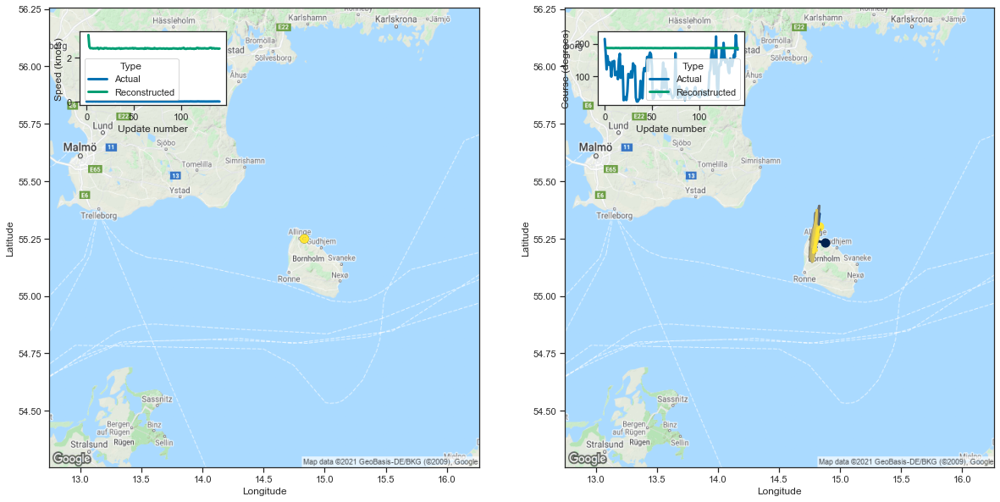

[3.0336697101593018, 2.508418321609497, 2.432234525680542, 2.4349052906036377]


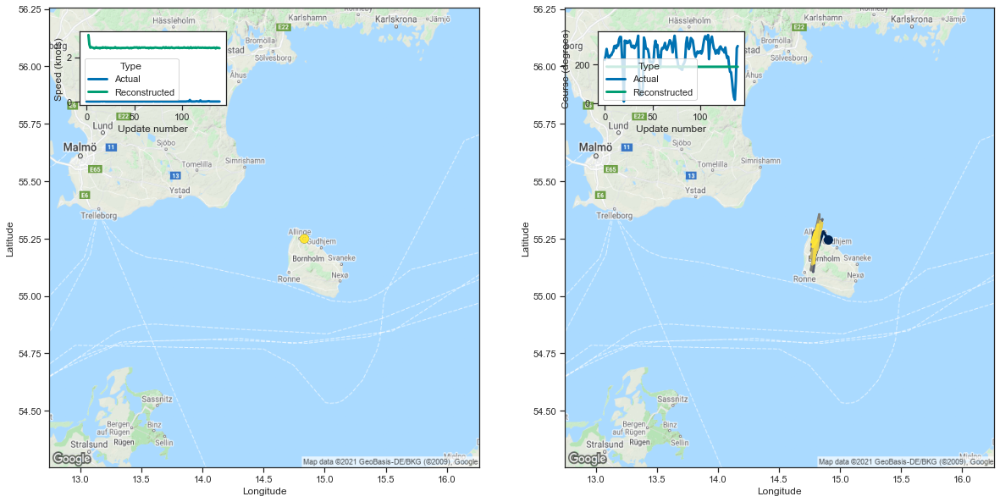

[3.001429557800293, 2.571429491043091, 2.4300625324249268, 2.4465487003326416]


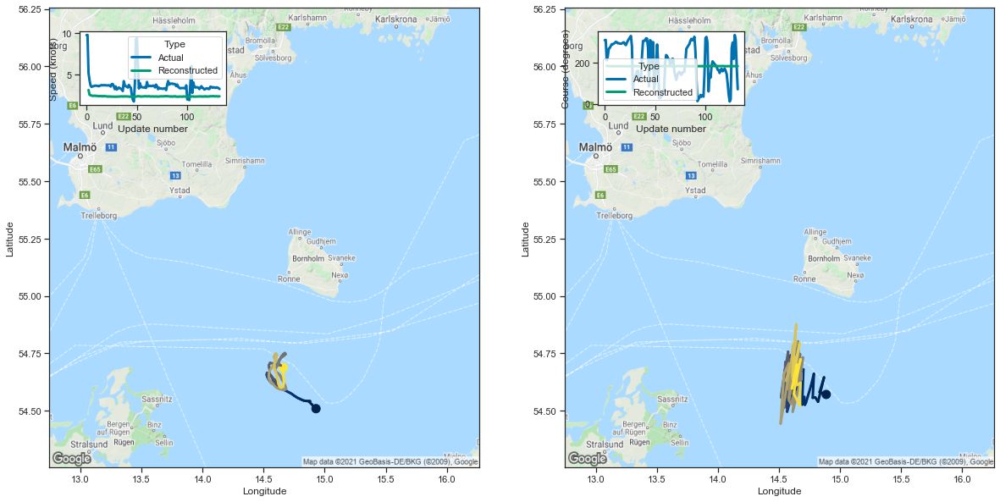

[3.1752378940582275, 2.5984926223754883, 2.5473837852478027, 2.494446277618408]


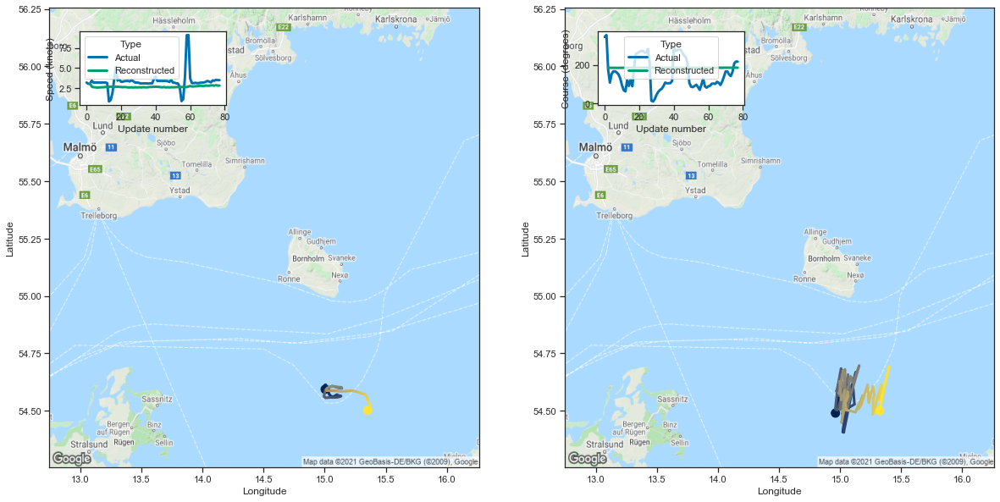

[3.097290515899658, 2.695800304412842, 2.6196393966674805, 2.6078860759735107]


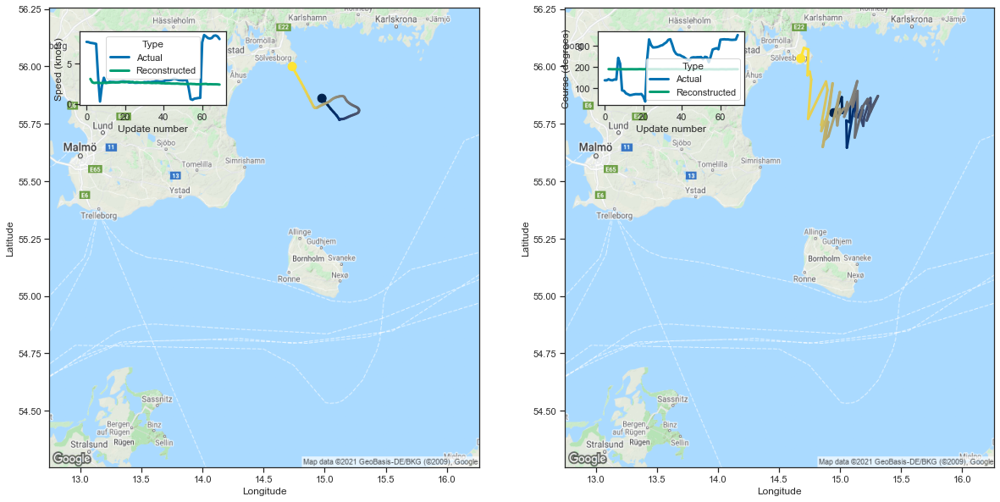

[3.0751254558563232, 2.6567370891571045, 2.5763070583343506, 2.6016876697540283]


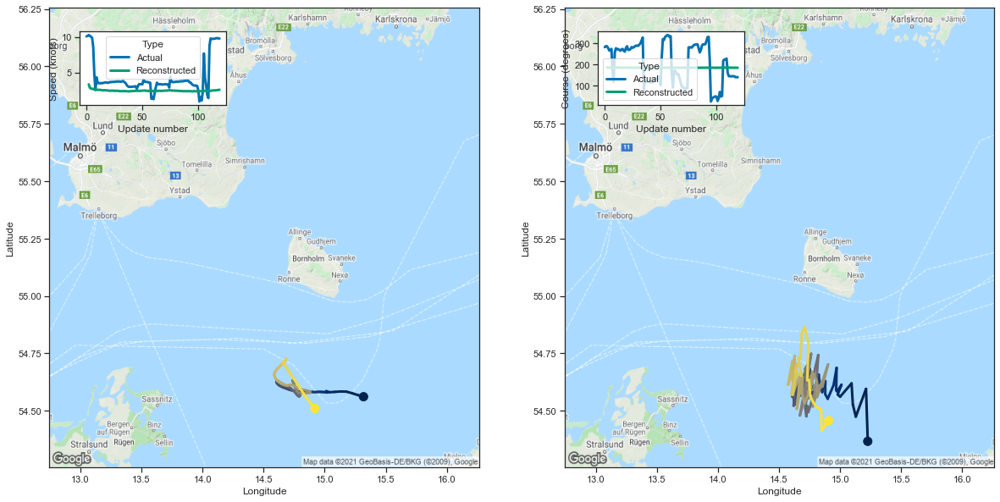

[3.35829758644104, 2.8675830364227295, 2.769148588180542, 2.714651346206665]


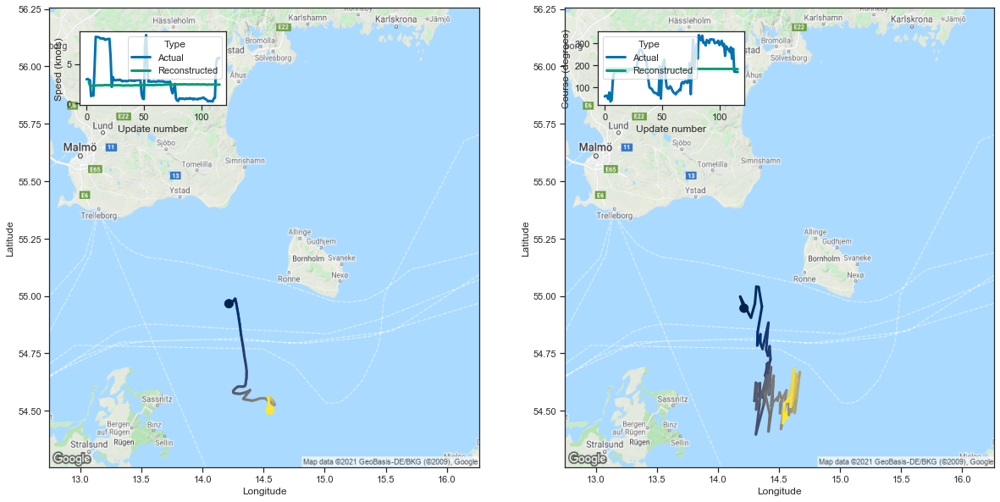

[2.718733787536621, 2.2578773498535156, 2.230445384979248, 2.2317404747009277]


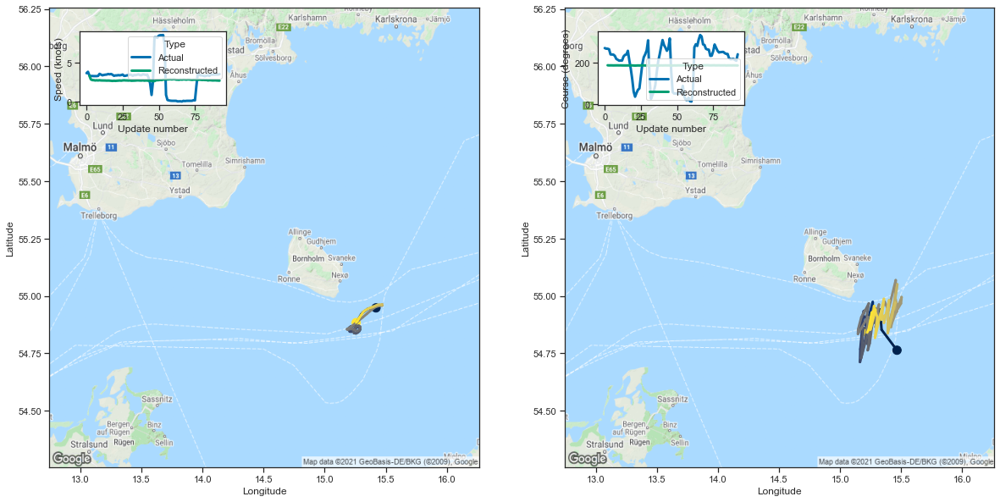

[3.3457839488983154, 2.873049736022949, 2.7853121757507324, 2.7750375270843506]


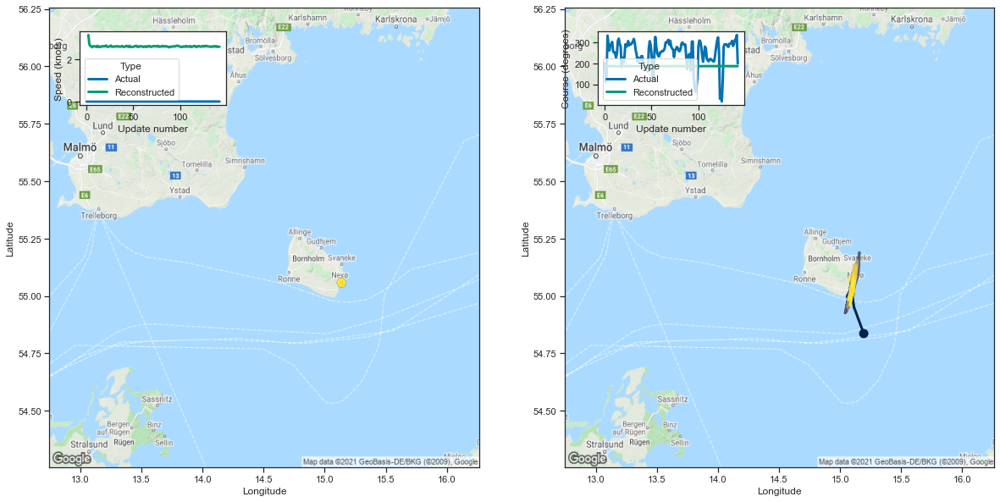

[3.166245460510254, 2.736743211746216, 2.6439549922943115, 2.6292169094085693]


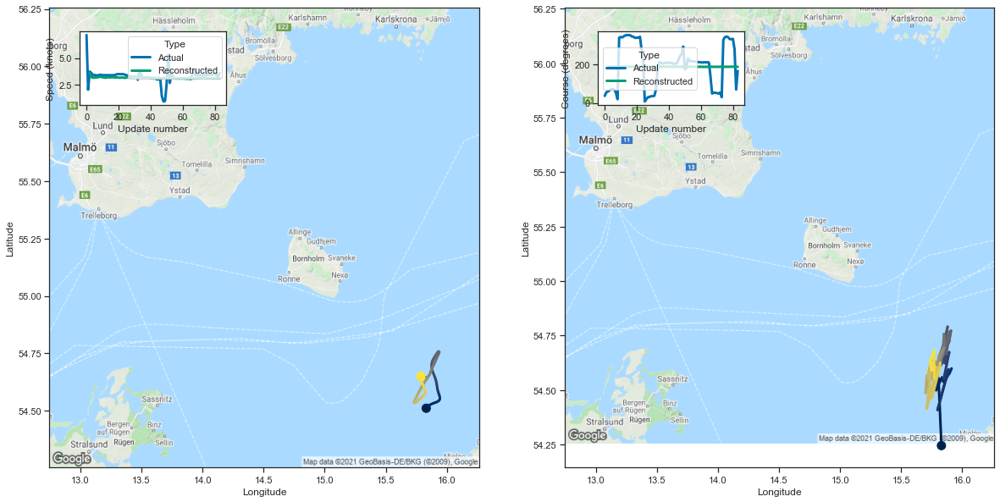

[3.6380903720855713, 3.239840507507324, 3.1569504737854004, 3.1823601722717285]


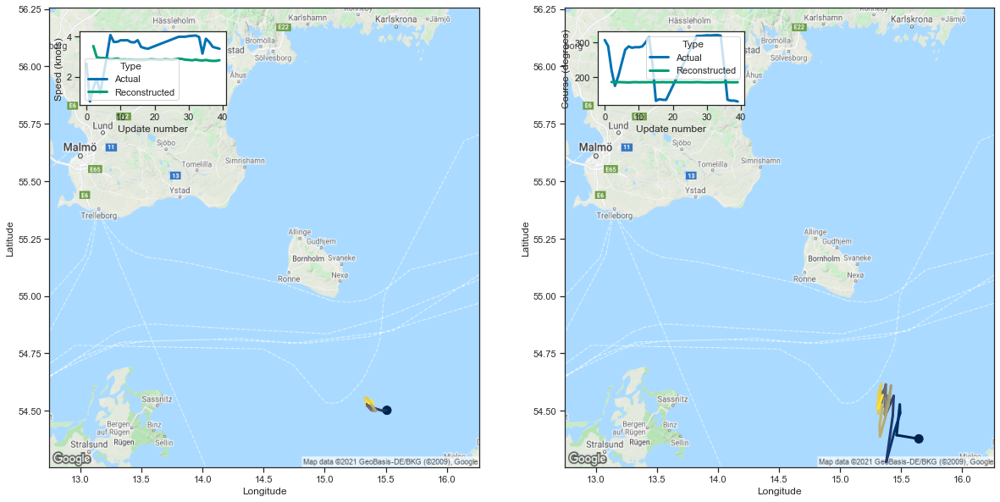

[3.5375750064849854, 2.9749722480773926, 2.940035820007324, 2.93715500831604]


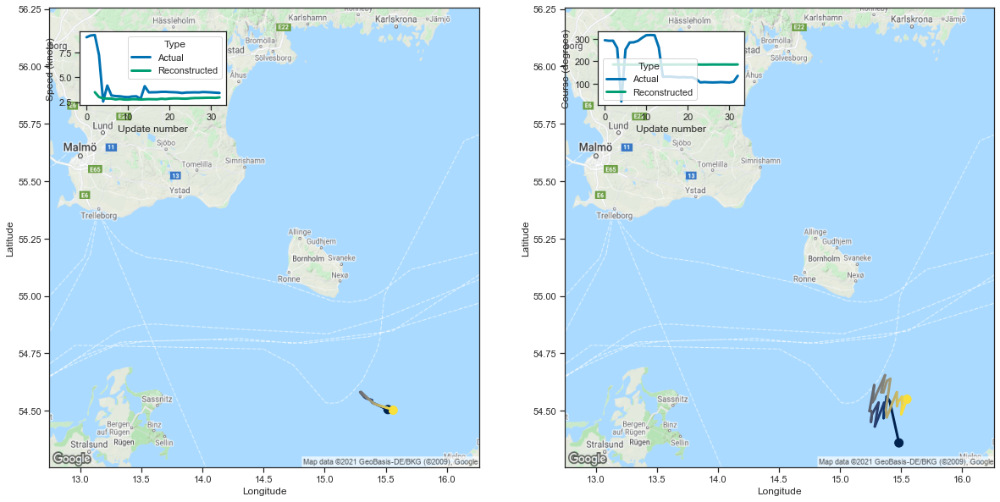

[3.4955925941467285, 3.0121562480926514, 2.8780128955841064, 2.856793165206909]


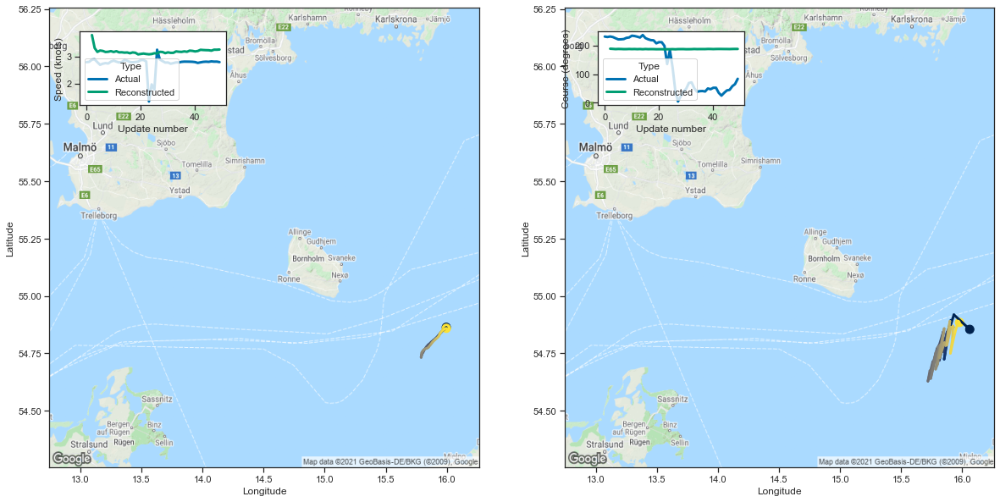

[3.781585693359375, 3.305344581604004, 3.1622977256774902, 3.2137863636016846]


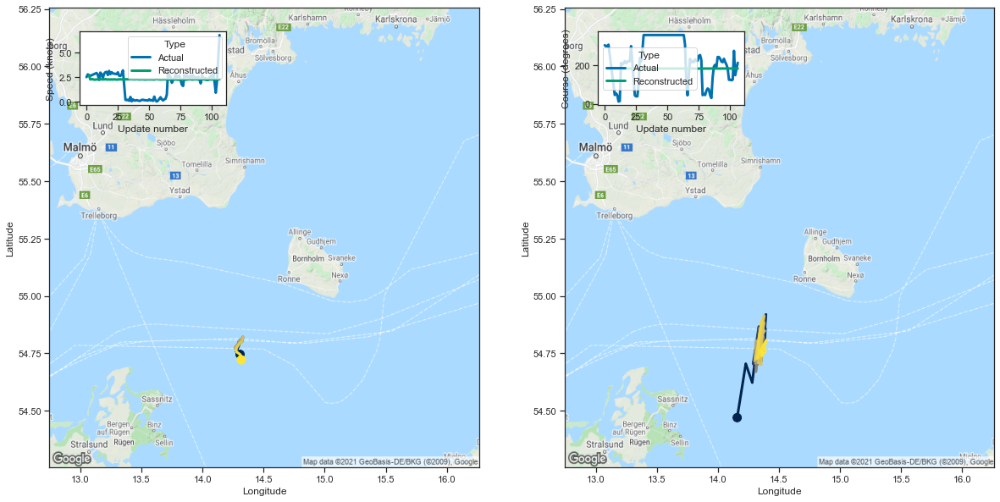

[2.663069486618042, 2.261455535888672, 2.2780871391296387, 2.277355909347534]


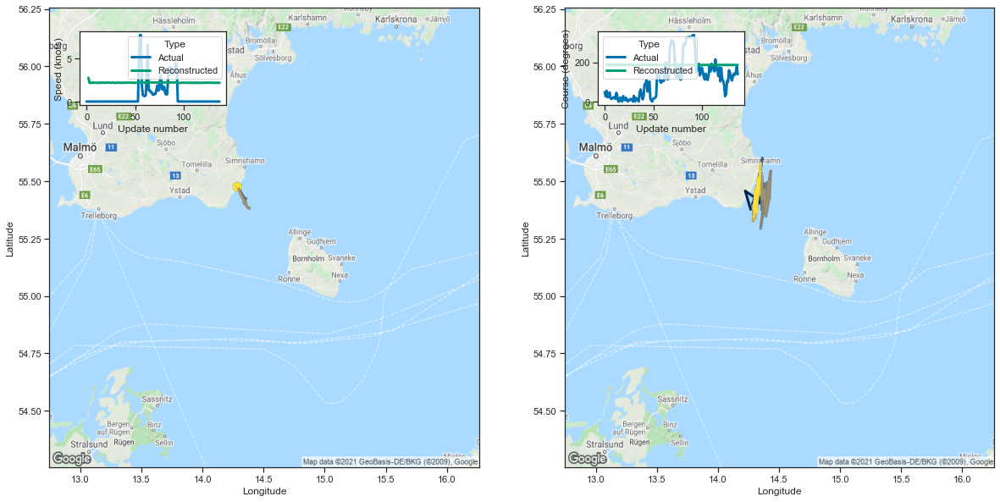

[2.7625999450683594, 2.203115701675415, 2.173090696334839, 2.1782984733581543]


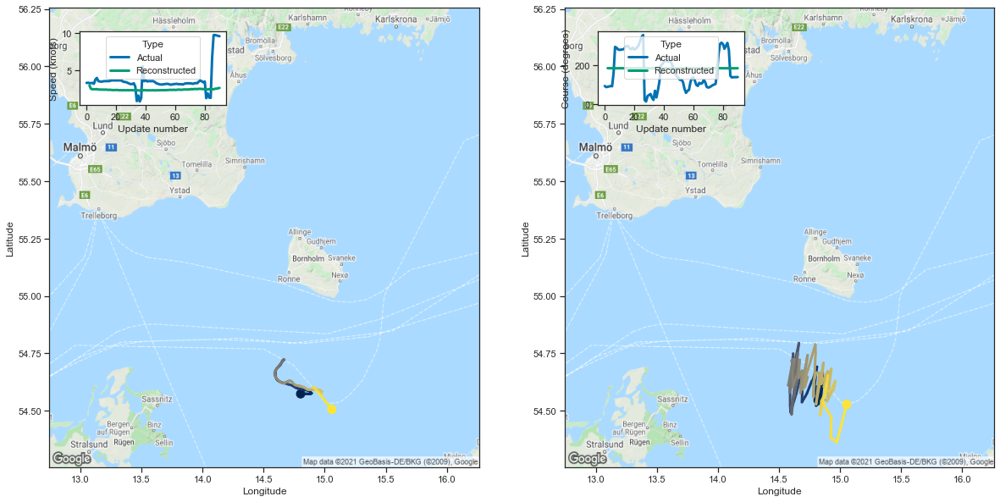

[3.0331194400787354, 2.5842511653900146, 2.52531099319458, 2.5300111770629883]


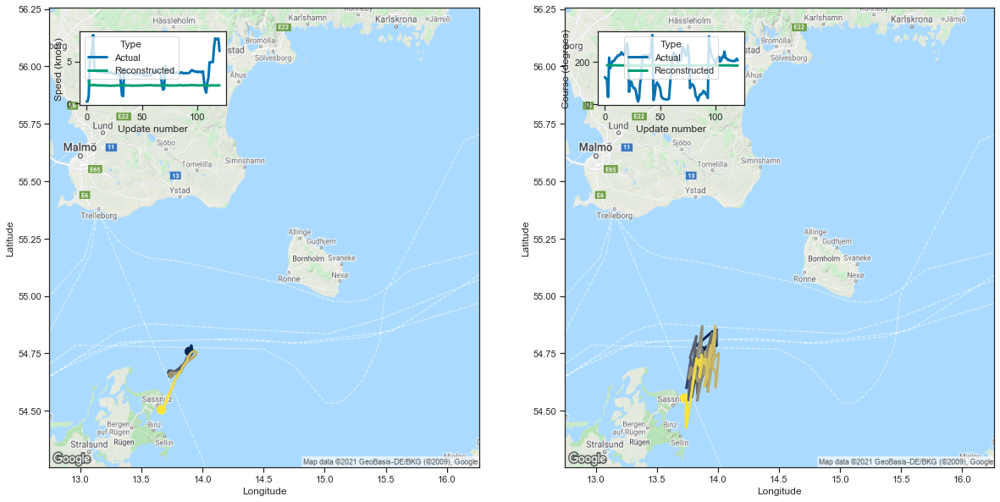

[2.658616065979004, 2.144979238510132, 2.138685941696167, 2.1545629501342773]


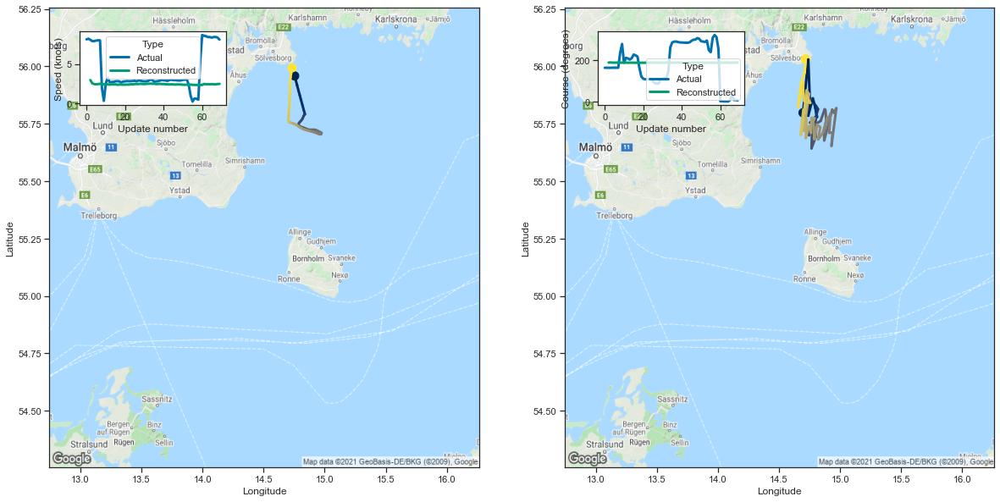

[2.9521677494049072, 2.529392719268799, 2.4473602771759033, 2.4087018966674805]


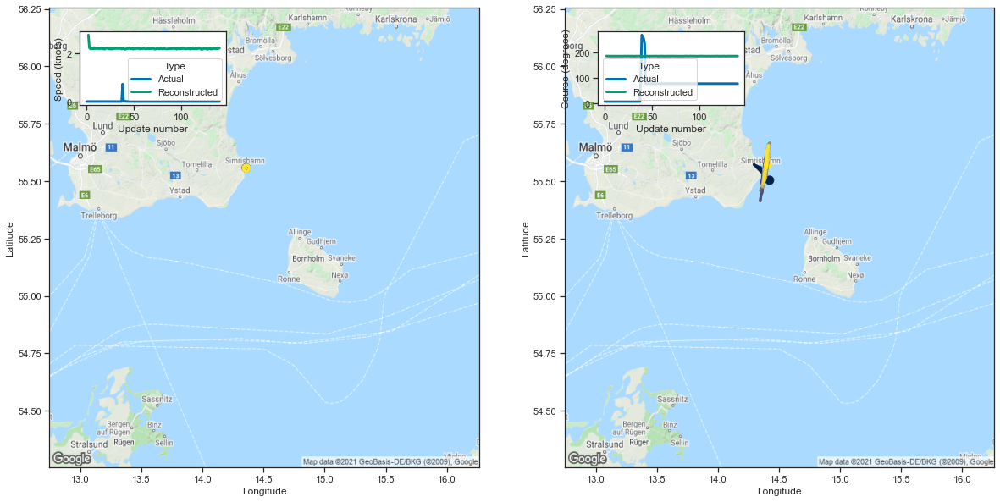

[2.781951665878296, 2.250779867172241, 2.2050628662109375, 2.2021498680114746]


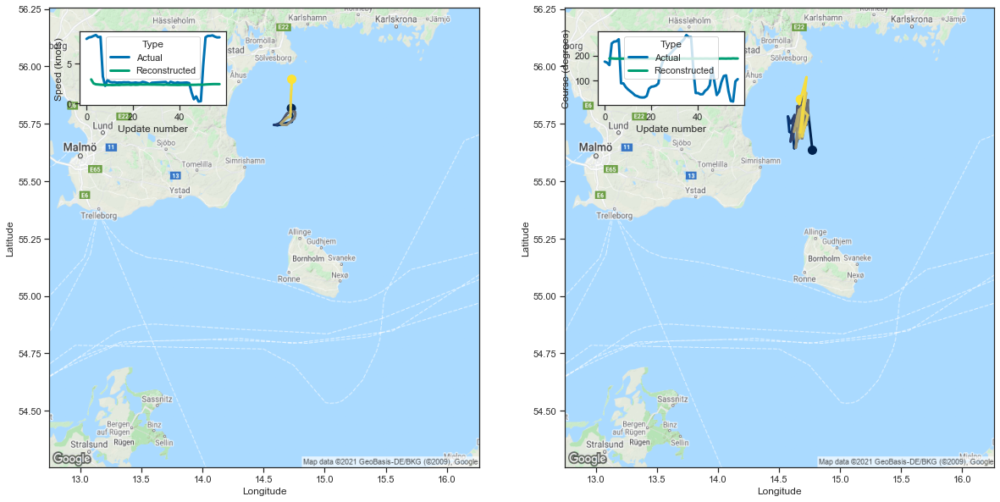

[3.011463165283203, 2.508450746536255, 2.389979124069214, 2.367201328277588]


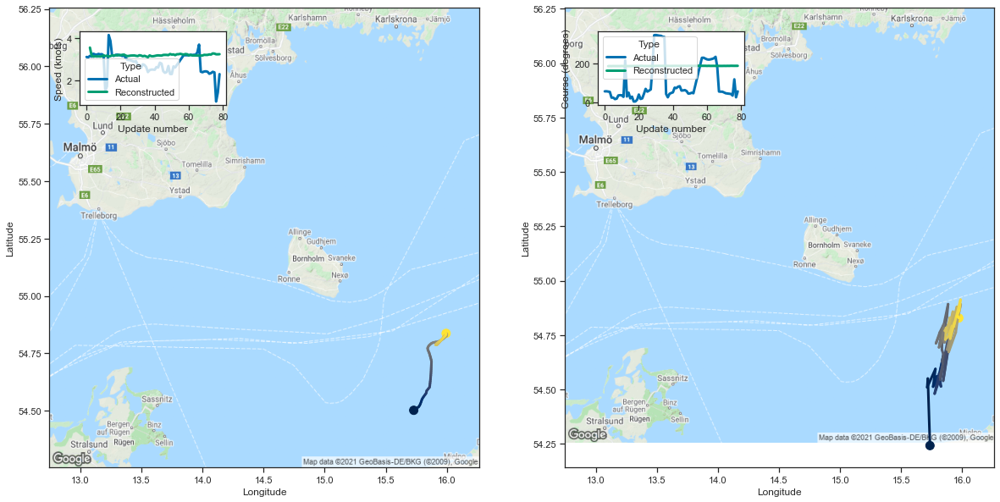

[3.5572268962860107, 3.1768760681152344, 3.127333879470825, 3.1466190814971924]


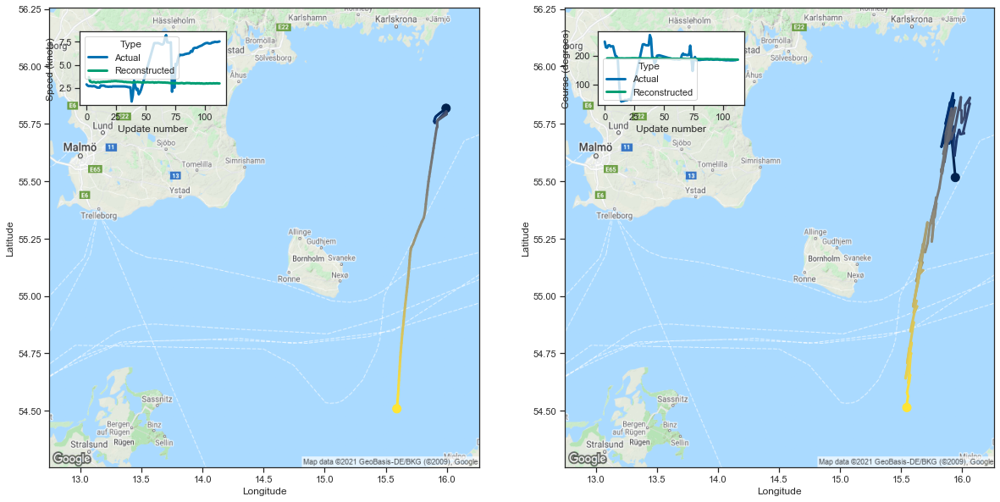

[3.6583101749420166, 3.197300910949707, 3.134121894836426, 3.1024186611175537]


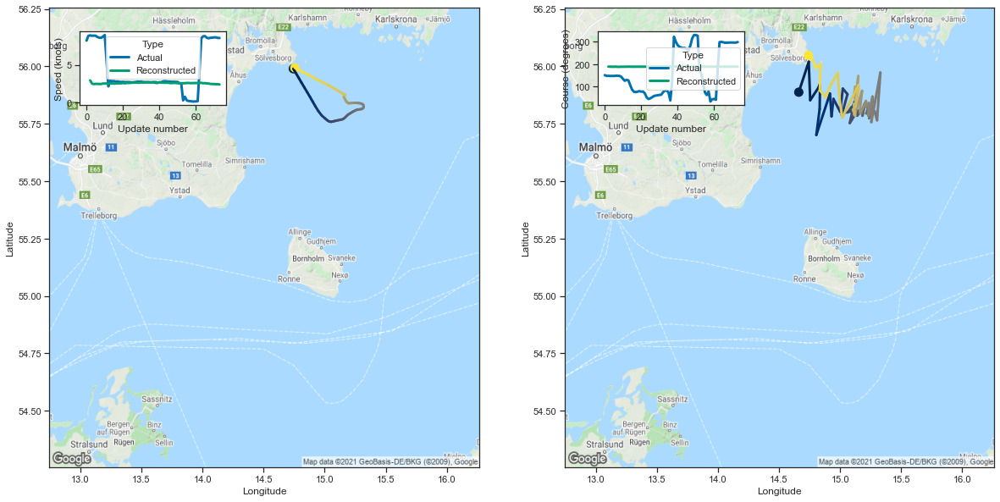

[2.947859525680542, 2.5336828231811523, 2.4677419662475586, 2.497007131576538]


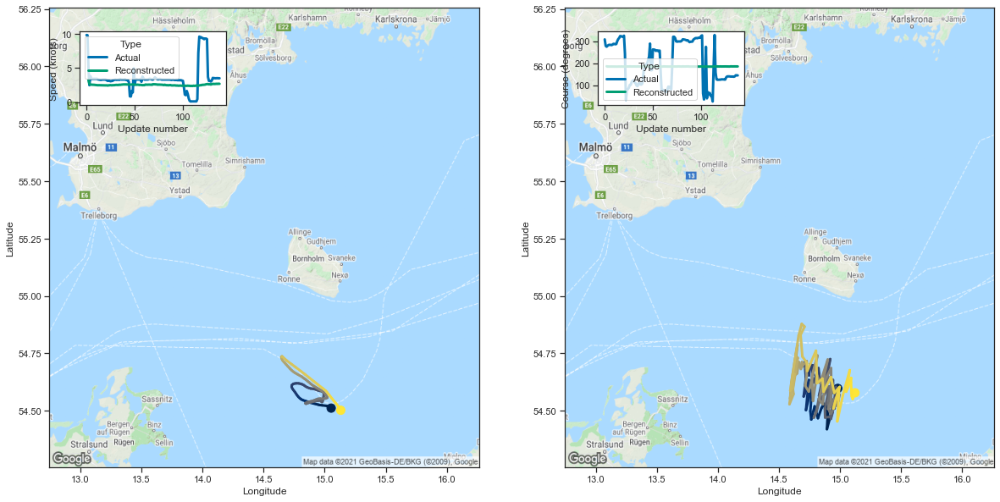

[3.210319995880127, 2.655463218688965, 2.5587377548217773, 2.552828788757324]


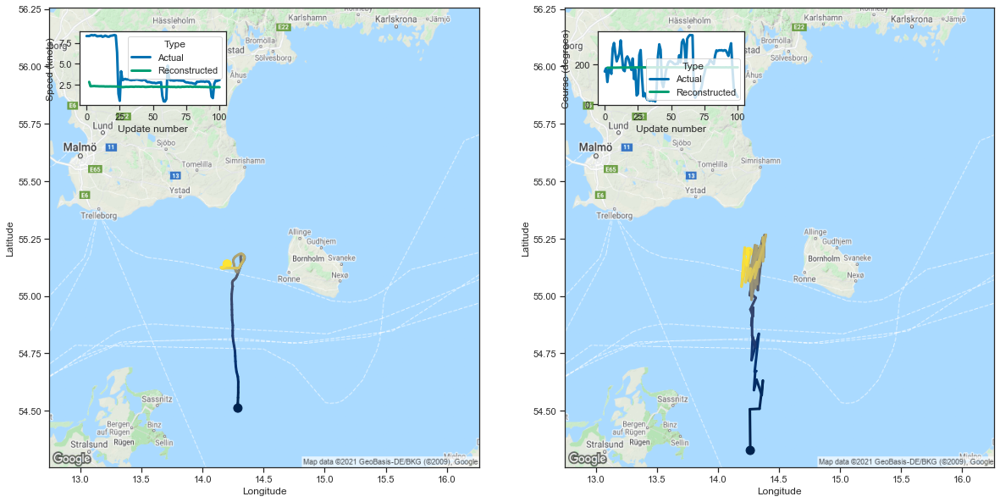

[2.8164172172546387, 2.2935495376586914, 2.3025896549224854, 2.315945863723755]


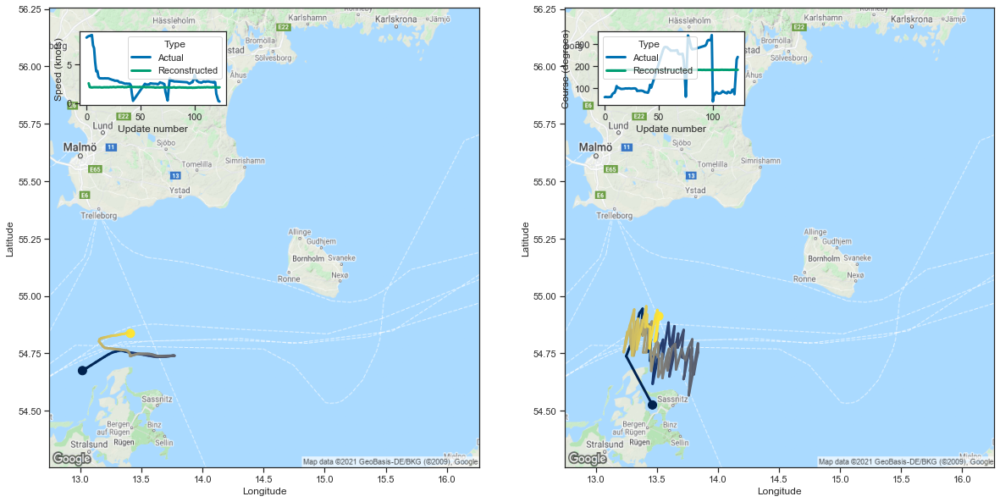

[2.570014476776123, 2.0756382942199707, 2.0352623462677, 2.0208075046539307]


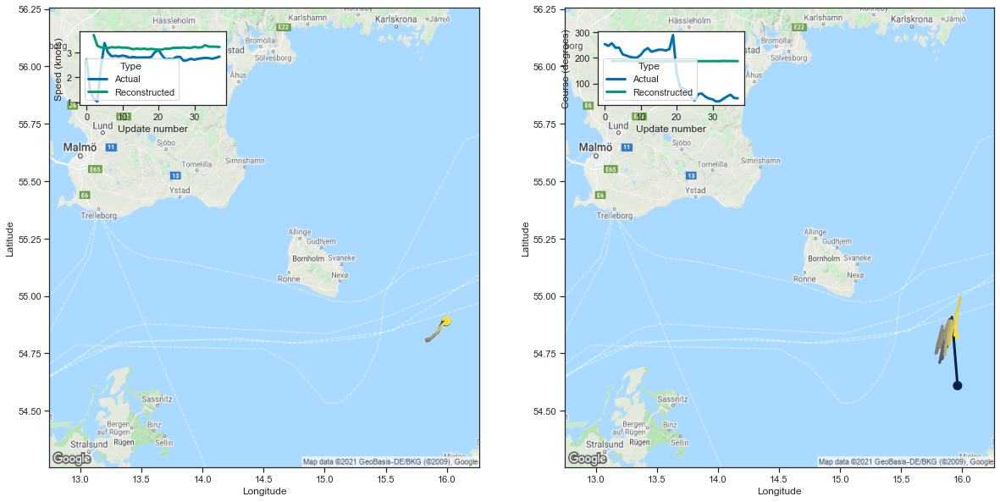

[3.705376386642456, 3.277205467224121, 3.207160711288452, 3.194455862045288]


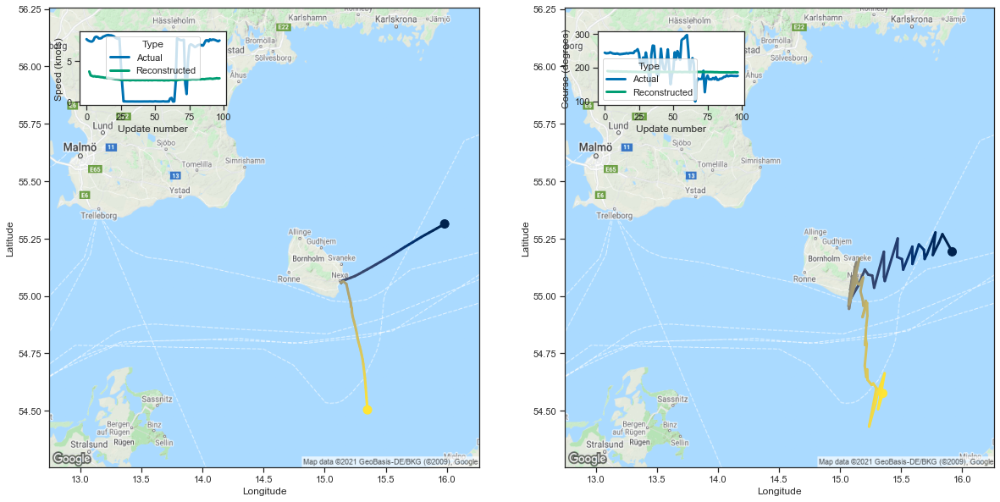

[3.6908886432647705, 3.220402479171753, 3.1418206691741943, 3.0850942134857178]


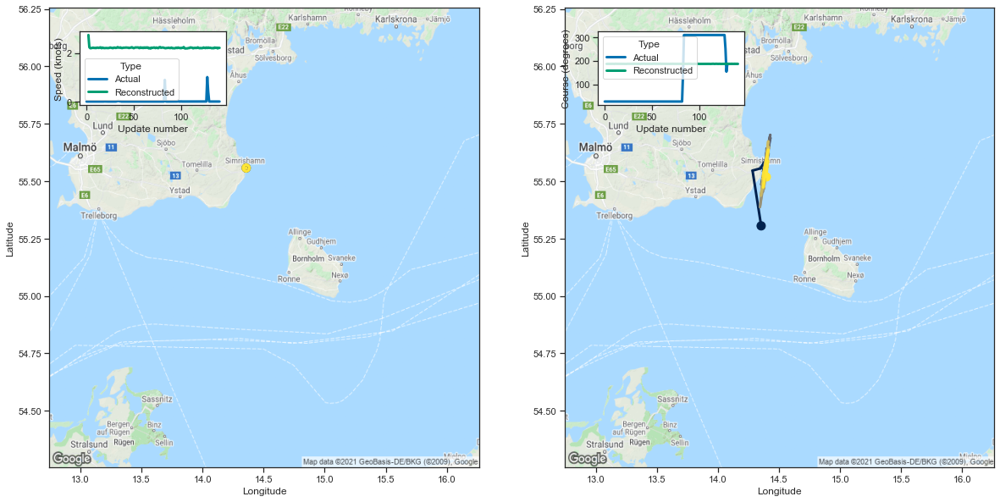

[2.740200996398926, 2.23661208152771, 2.197516918182373, 2.1994242668151855]


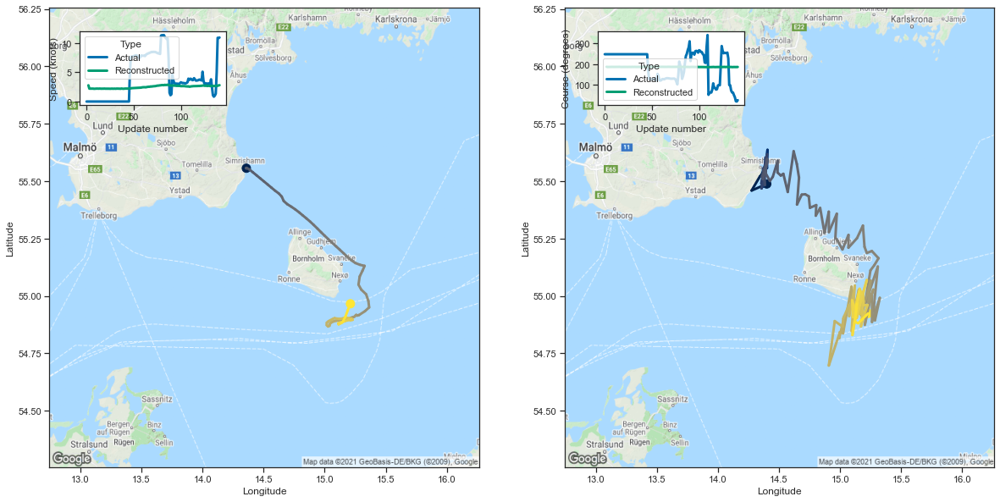

[2.778536081314087, 2.206836462020874, 2.210432291030884, 2.2077200412750244]


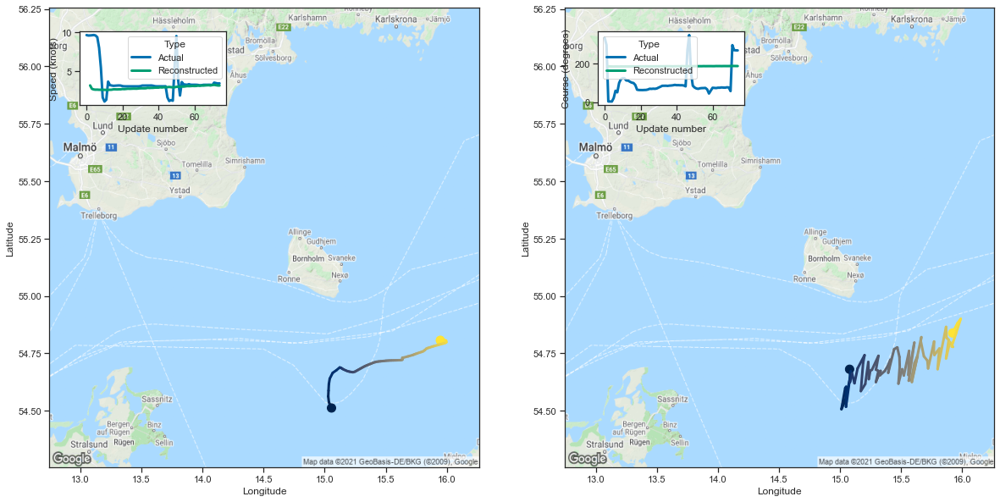

[3.215986967086792, 2.781825304031372, 2.69958758354187, 2.6726186275482178]


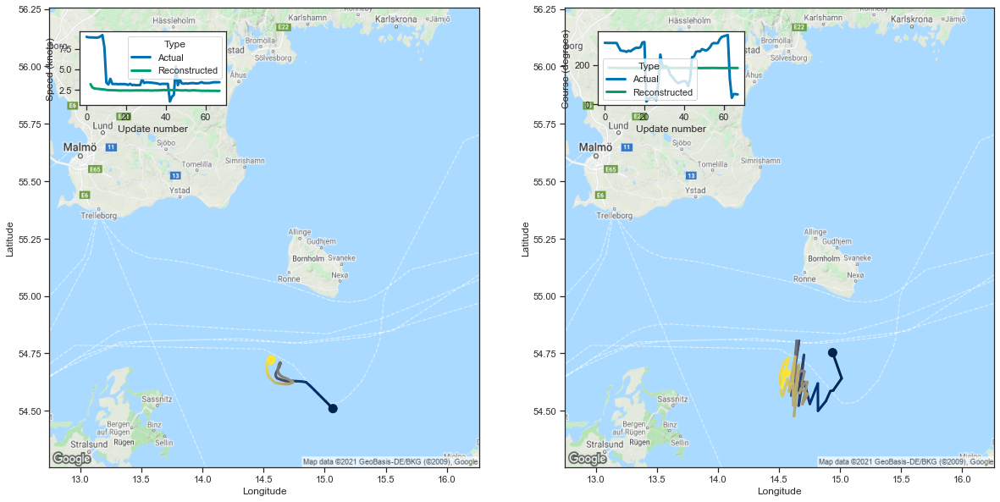

[3.169137716293335, 2.7556092739105225, 2.638343334197998, 2.6034159660339355]


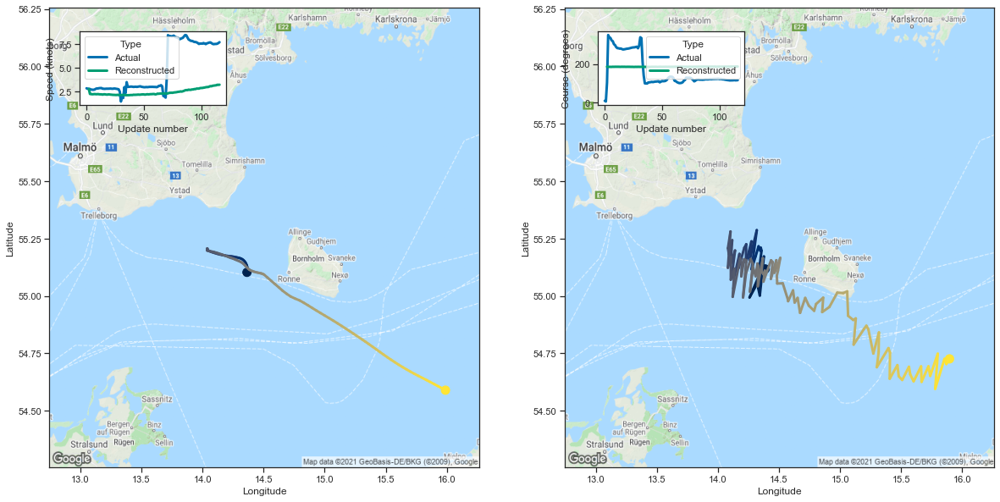

[2.7793593406677246, 2.2533812522888184, 2.239926338195801, 2.222275733947754]


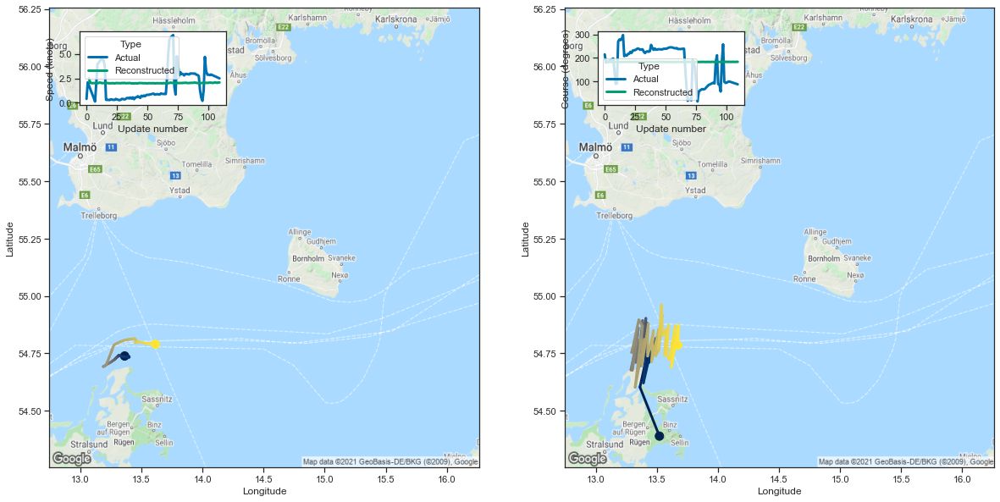

[2.5226099491119385, 2.0563976764678955, 2.0193426609039307, 2.007152795791626]


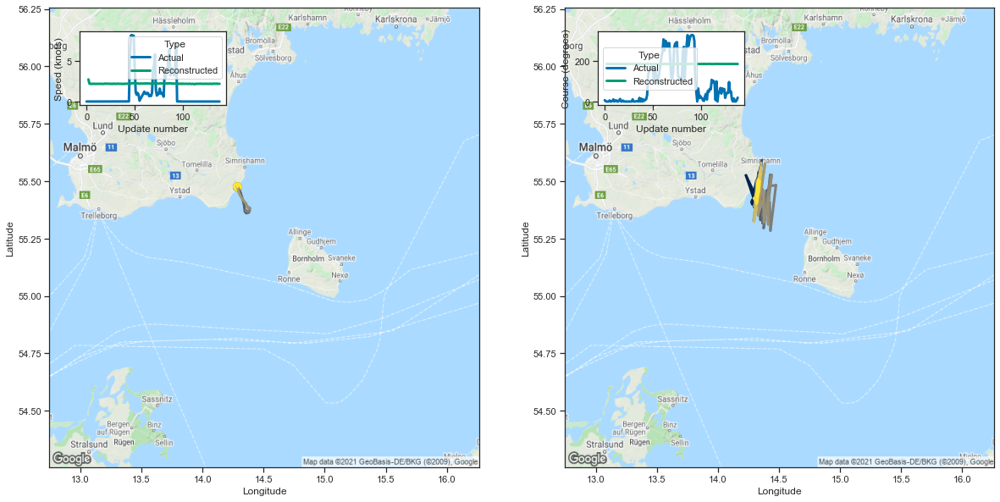

[2.737274646759033, 2.2199642658233643, 2.1834897994995117, 2.1917381286621094]


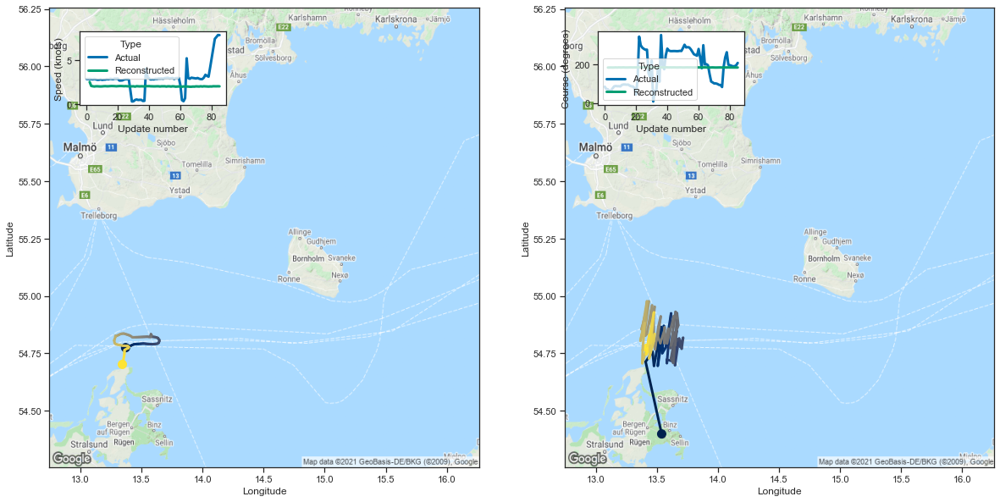

[2.5474252700805664, 2.0878424644470215, 2.0522282123565674, 2.0254921913146973]


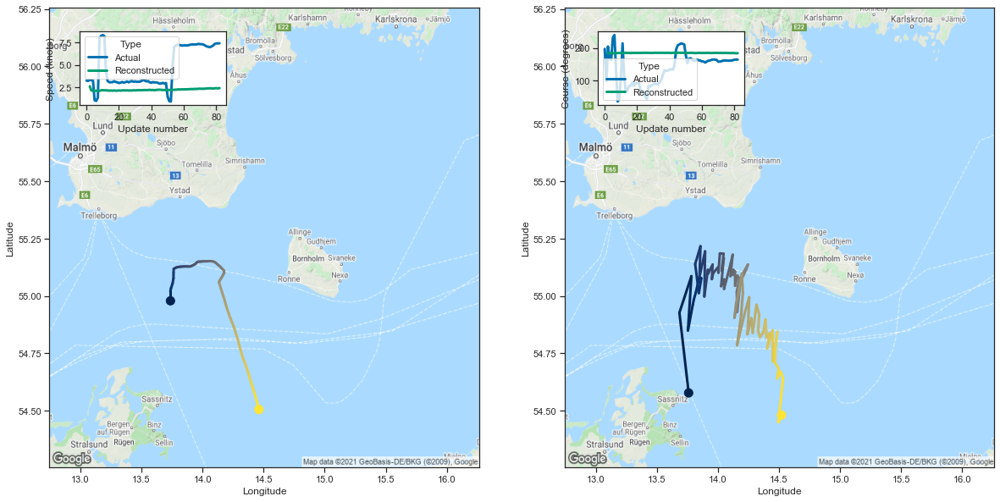

[2.583202600479126, 2.1104495525360107, 2.0803933143615723, 2.0891330242156982]


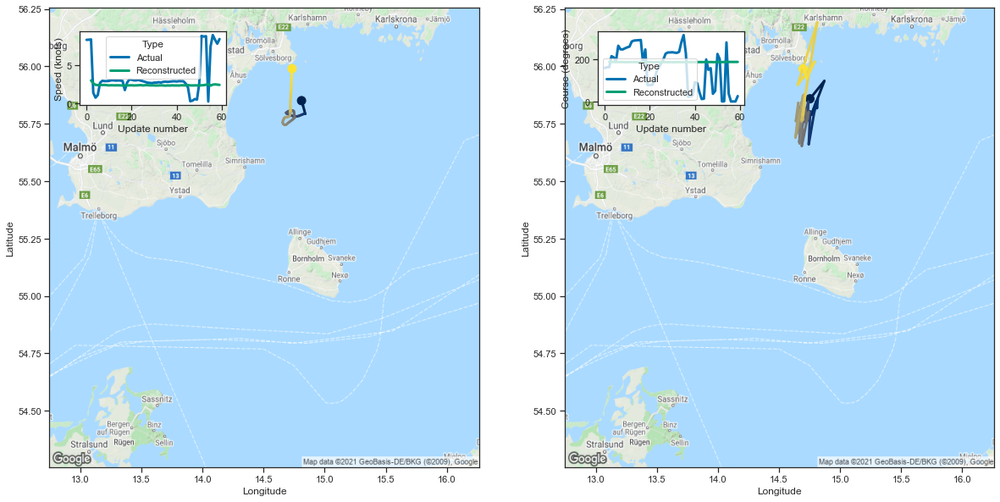

[2.9887654781341553, 2.594489812850952, 2.4077420234680176, 2.3788437843322754]


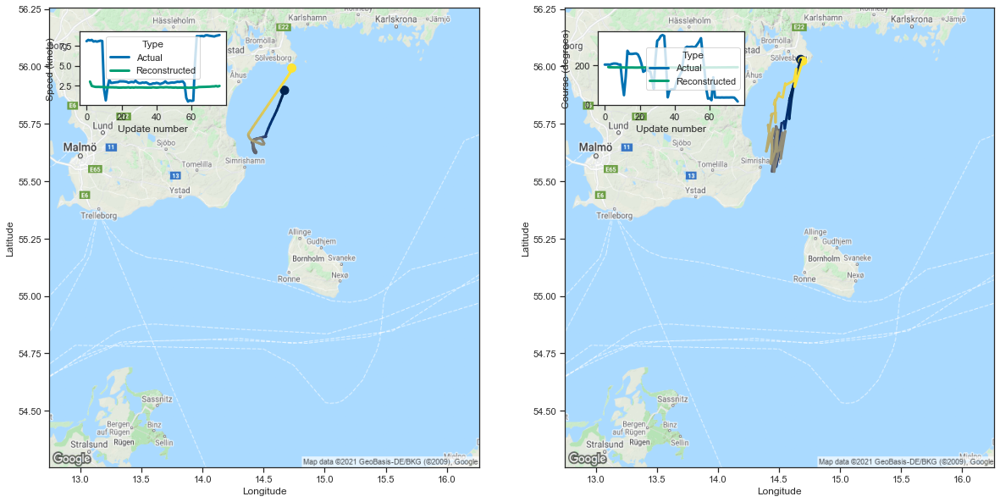

[2.998044013977051, 2.4495725631713867, 2.384809970855713, 2.331355571746826]


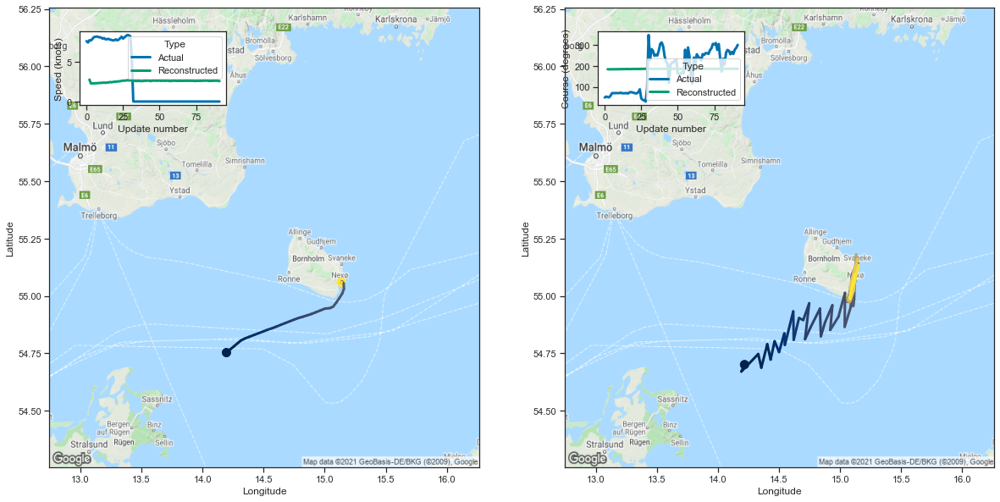

[2.777099132537842, 2.284752130508423, 2.289076089859009, 2.293267250061035]


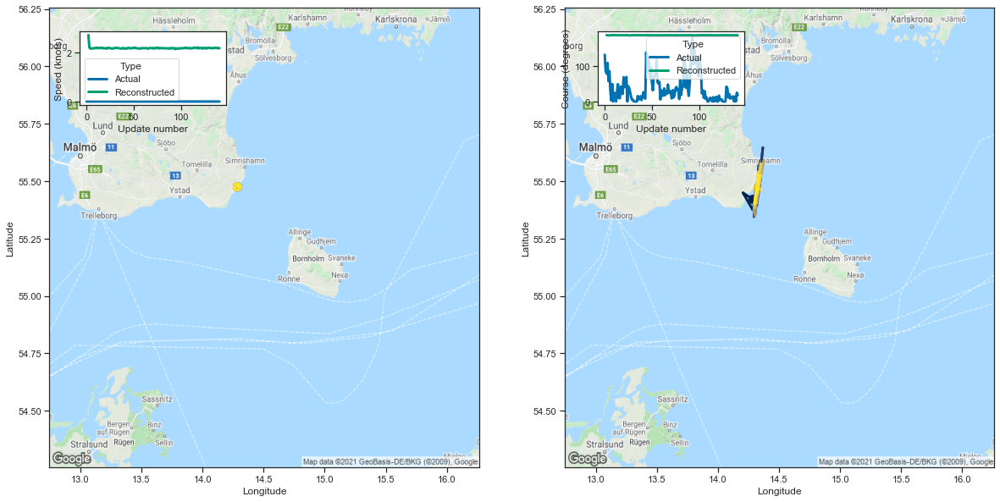

[2.7350354194641113, 2.227705240249634, 2.178030252456665, 2.1857070922851562]


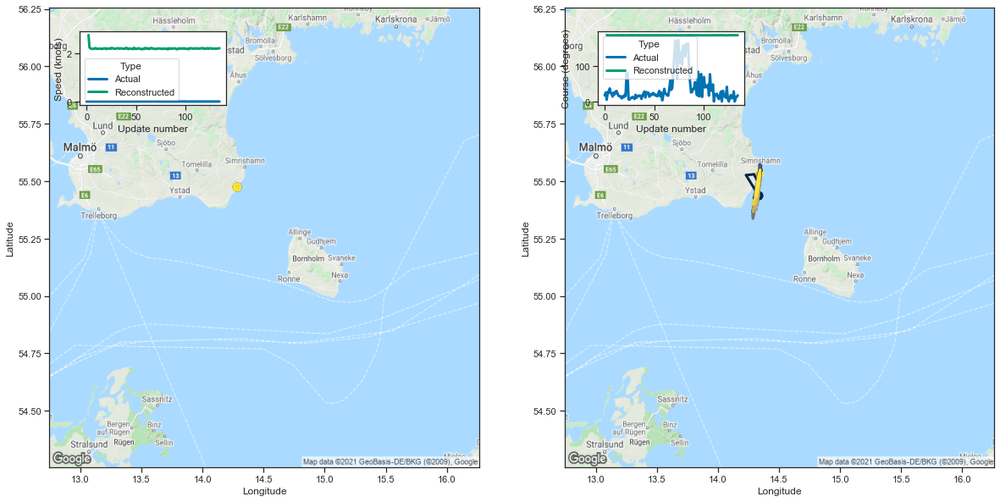

[2.7539639472961426, 2.2374351024627686, 2.198427438735962, 2.1870832443237305]


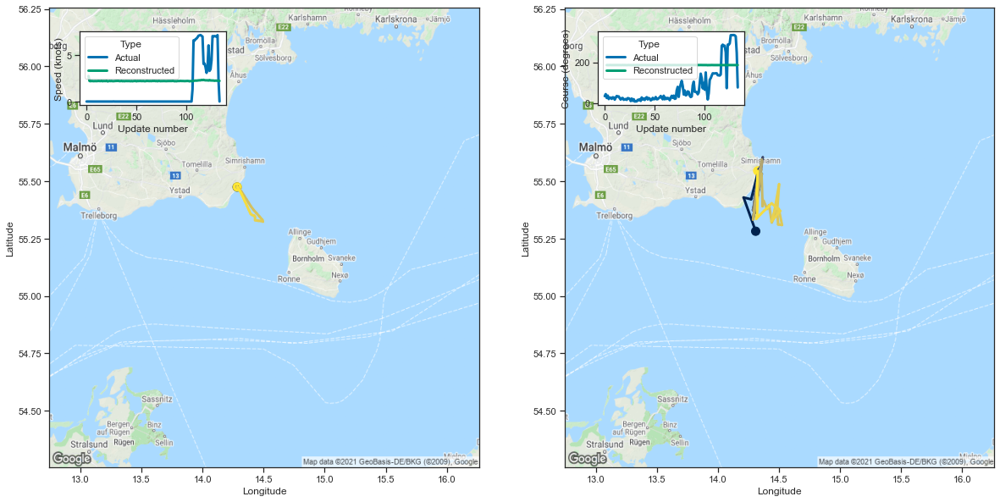

[2.73640513420105, 2.202126979827881, 2.1833925247192383, 2.2039713859558105]


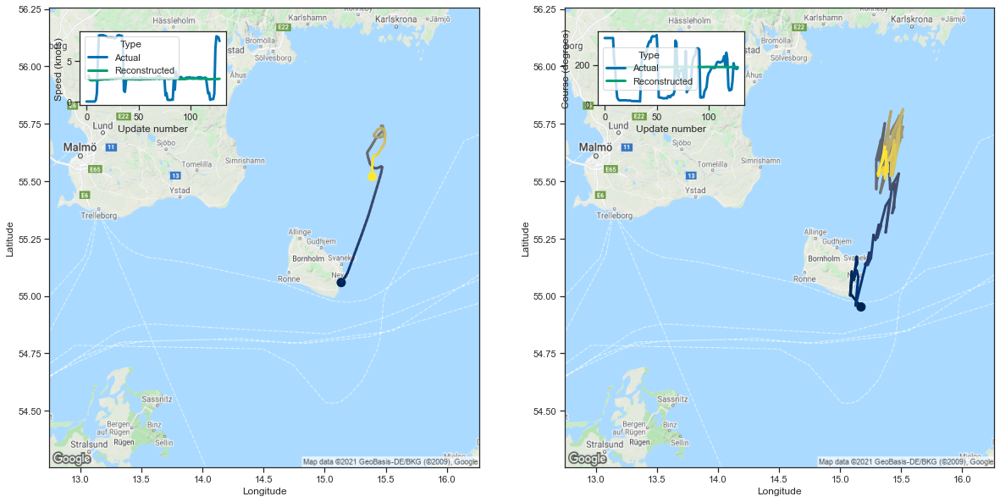

[3.175365447998047, 2.7033236026763916, 2.623271942138672, 2.6060876846313477]


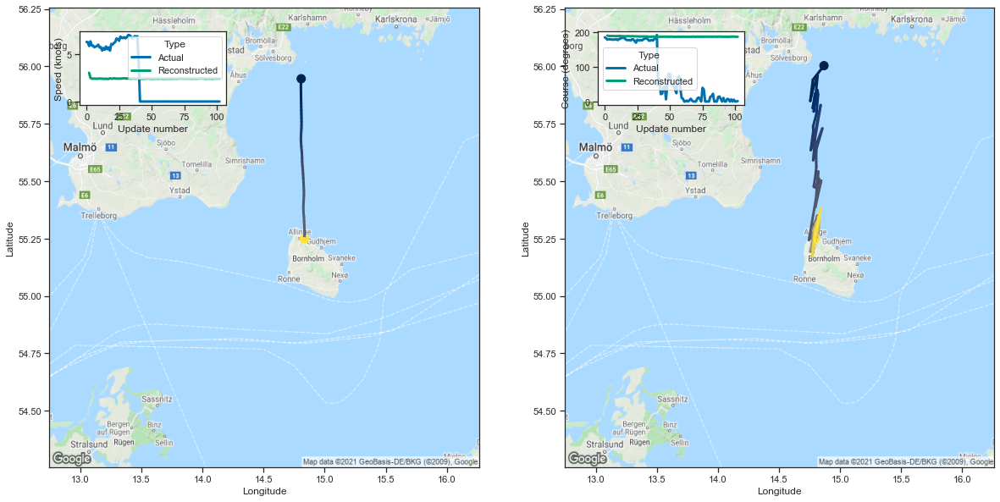

[3.0426559448242188, 2.492466926574707, 2.4237749576568604, 2.4150283336639404]


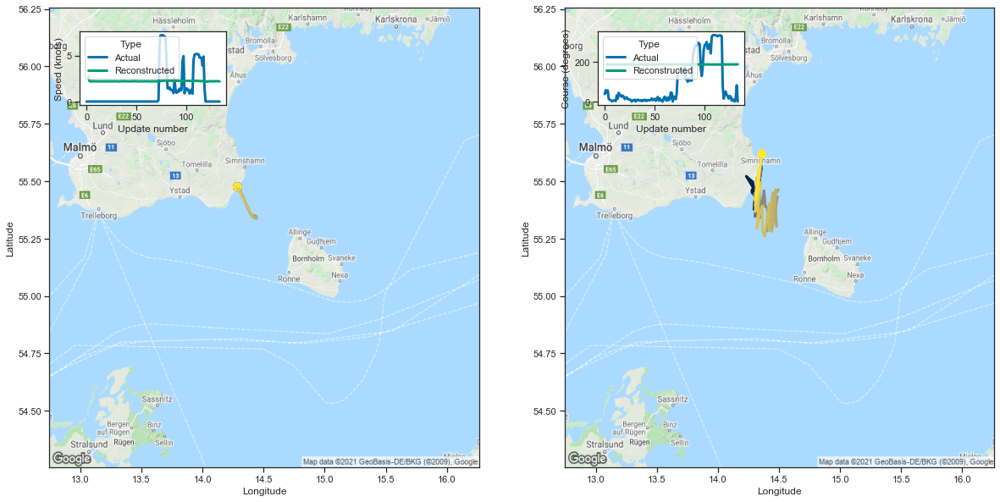

[2.7134950160980225, 2.2135863304138184, 2.1825554370880127, 2.1745645999908447]


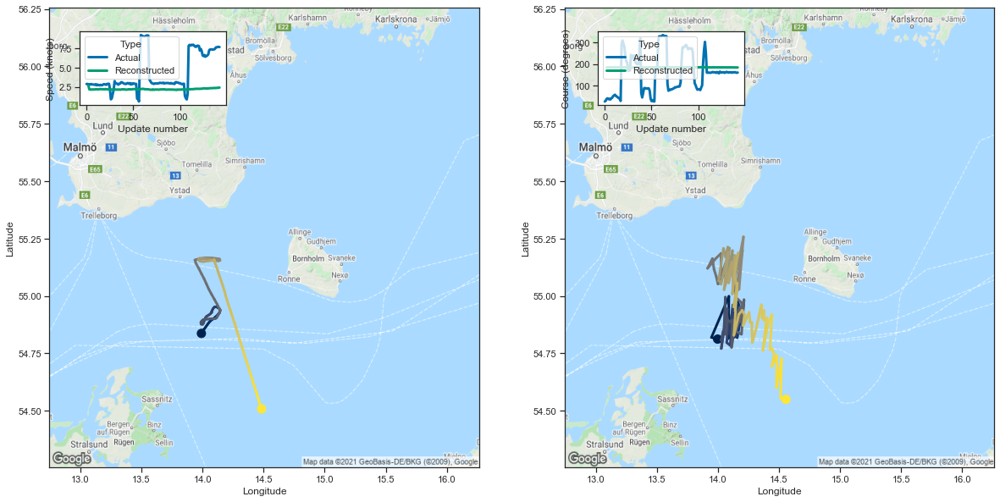

[2.670504570007324, 2.165306806564331, 2.165477991104126, 2.1327579021453857]


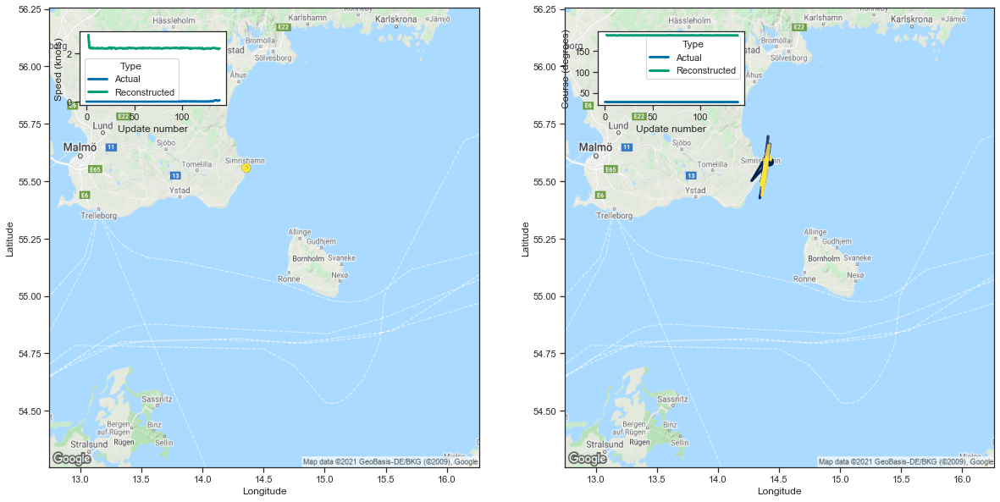

[2.762080192565918, 2.2405295372009277, 2.21100115776062, 2.230329751968384]


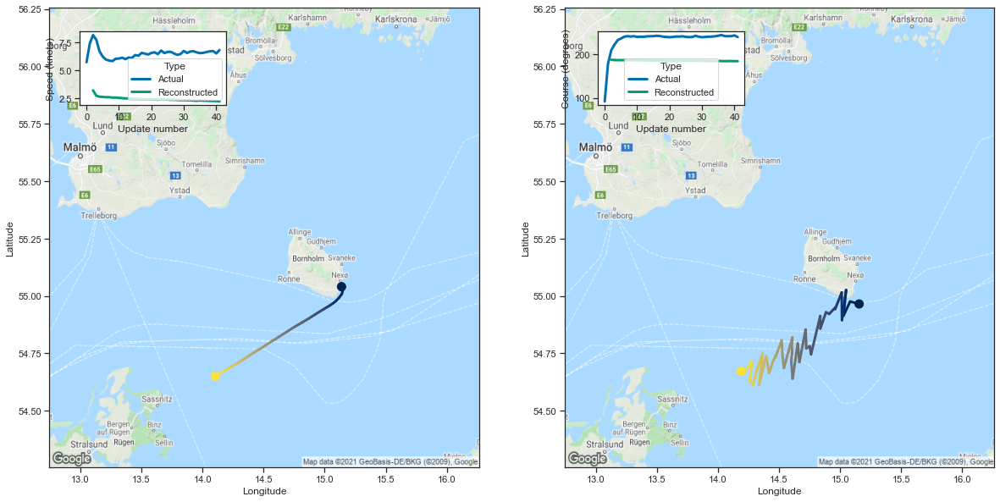

[3.2085533142089844, 2.731259346008301, 2.641226053237915, 2.6281955242156982]


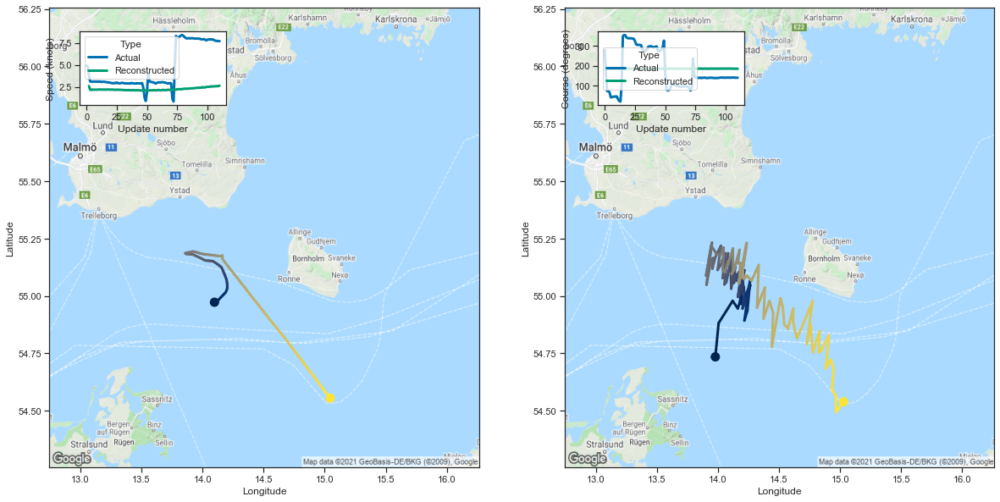

[2.6045351028442383, 2.1754653453826904, 2.1700873374938965, 2.1991937160491943]


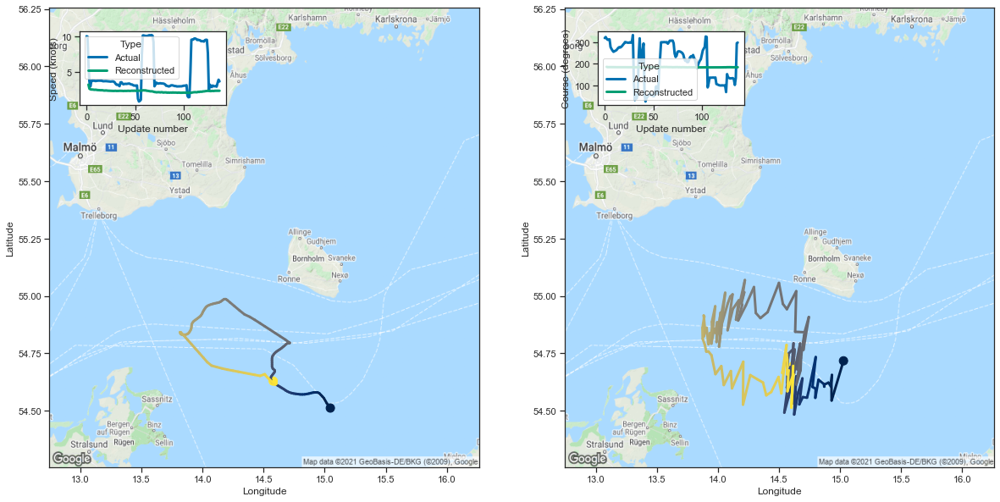

[3.2587473392486572, 2.682253360748291, 2.6025214195251465, 2.5643069744110107]


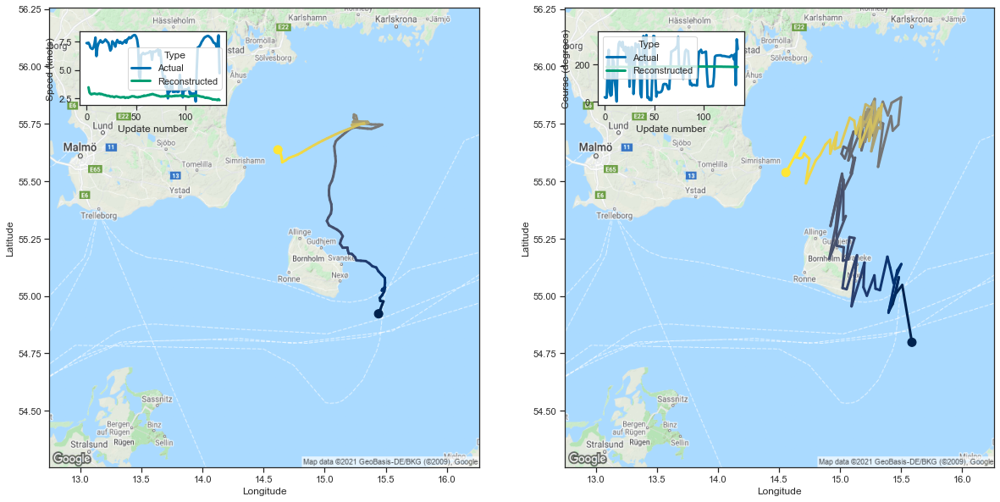

[3.4639759063720703, 3.002077102661133, 2.8882436752319336, 2.83935546875]


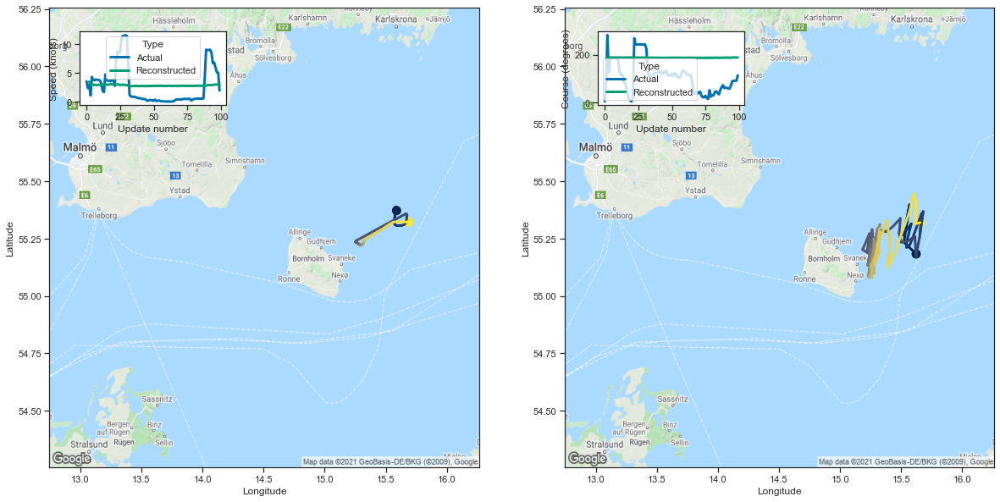

[3.4536330699920654, 2.968179225921631, 2.9294419288635254, 2.9195122718811035]


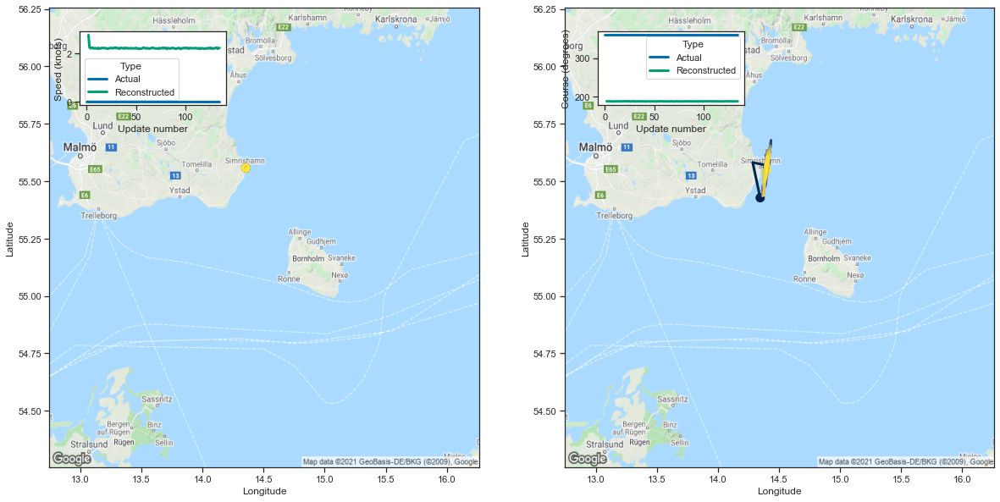

[2.766561269760132, 2.2448370456695557, 2.2140960693359375, 2.221742868423462]


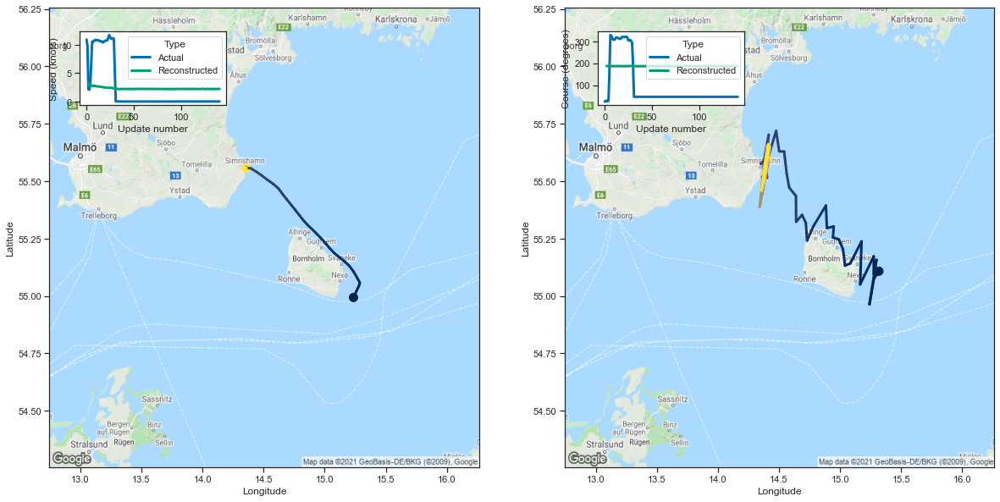

[3.319302797317505, 2.8336167335510254, 2.726909875869751, 2.769530773162842]


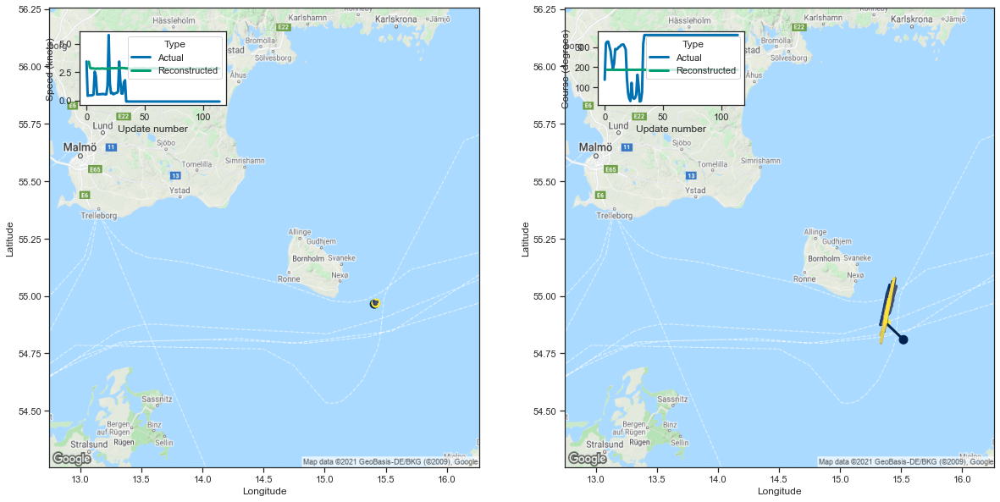

[3.4164586067199707, 2.885100841522217, 2.813019275665283, 2.830752372741699]


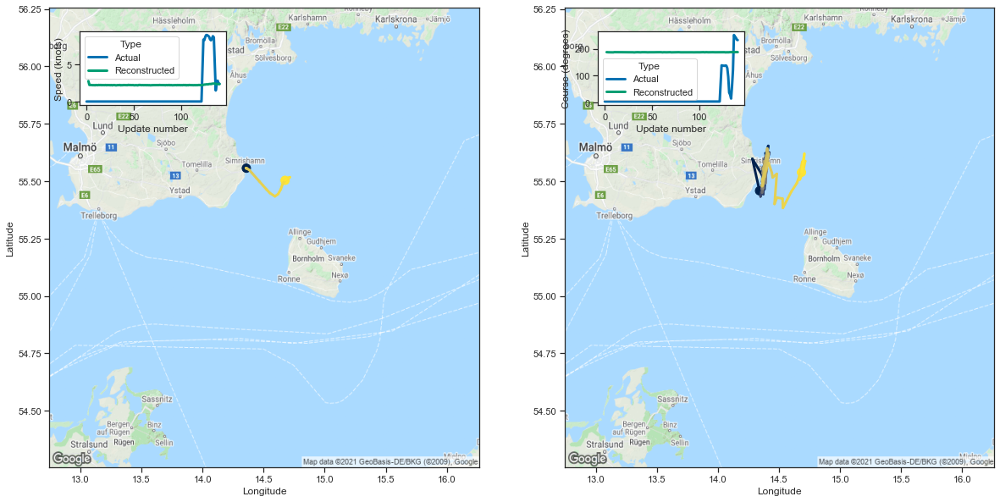

[2.758699417114258, 2.24436092376709, 2.2296621799468994, 2.2335851192474365]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
8,8,1943886,230069190,Fishing,135,-738.168945,-5.467918
4,4,2259131,230069190,Fishing,141,-772.286682,-5.477211
17,17,6685896,265759000,Fishing,143,-786.828125,-5.502295
74,74,6962046,265759000,Fishing,143,-789.504272,-5.521009
29,29,6787151,265759000,Fishing,143,-794.075134,-5.552973
...,...,...,...,...,...,...,...
5,5,6496,211215500,Fishing,100,-695.294312,-6.952943
100,100,1583421,219021428,Fishing,135,-946.871399,-7.013862
23,23,5544210,265750000,Fishing,142,-1006.235046,-7.086162
56,56,4380691,261017210,Fishing,115,-818.937378,-7.121195


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n